In [188]:
import numpy as np
import pandas as pd
from glob import glob 
from tqdm import tqdm
import seaborn as sns 

from sklearn.model_selection import train_test_split
from collections import Counter
from imblearn.under_sampling import RandomUnderSampler
import matplotlib.pyplot as plt


from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score
from sklearn.metrics import roc_curve, roc_auc_score, auc
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.utils.multiclass import unique_labels
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.model_selection import GridSearchCV
from datetime import datetime


# for dimensionality reduction
from sklearn.decomposition import PCA

import lightgbm as lgb
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score


import h5py
import re
from sklearn.model_selection import RepeatedKFold
from sklearn.feature_selection import RFECV

from sklearn.preprocessing import LabelEncoder


import numpy as np
from sklearn.datasets import load_iris
from sklearn.model_selection import train_test_split
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
import xgboost as xgb
import lightgbm as lgb
from sklearn.metrics import f1_score

from scipy import stats
from scipy import signal

import pandas as pd
from sklearn.preprocessing import StandardScaler


from obspy.geodetics.base import gps2dist_azimuth


from datetime import datetime, timedelta

# to compute the time
import time

from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
pd.set_option('display.max_columns', None)


import obspy

# importing the dependencies. 
import pandas as pd
import numpy as np
import scipy as sc
from scipy import signal

import matplotlib.pyplot as plt
import h5py
import obspy
from obspy.signal.filter import envelope
from obspy.clients.fdsn import Client
from tqdm import tqdm
from glob import glob
import tsfel
import random
from datetime import timedelta
import calendar

import concurrent.futures

import seis_feature
from seis_feature import compute_physical_features
from multiprocessing import Pool


from tsfel import time_series_features_extractor, get_features_by_domain
import concurrent.futures


## Defining functions for preprocessing. 

### Preprocessing include

- Applying a 10% cosine taper 
- Butterworth band pass filter on the tapered waveforms (1-10 Hz)
- Normalizing the filtered waveforms

In [9]:
def apply_cosine_taper(arrays, taper_percent=10):
    tapered_arrays = []
    
    #print(arrays.shape)
    num_samples = arrays.shape[1]  # Assuming each sub-array has the same length
    
    for array in arrays:
        

        taper_length = int(num_samples * taper_percent / 100)
        taper_window = np.hanning(2 * taper_length)
        
     
        tapered_array = array.copy()
        tapered_array[:taper_length] = tapered_array[:taper_length] * taper_window[:taper_length]
        tapered_array[-taper_length:] = tapered_array[-taper_length:] * taper_window[taper_length:]
        
        tapered_arrays.append(tapered_array)
    
    return np.array(tapered_arrays)              
              
    
    
def butterworth_filter(arrays, lowcut, highcut, fs, num_corners, filter_type='bandpass'):
    """
    Apply a Butterworth filter (bandpass, highpass, or lowpass) to each array in an array of arrays.

    Parameters:
        arrays (list of numpy arrays): List of arrays to be filtered.
        lowcut (float): Lower cutoff frequency in Hz.
        highcut (float): Upper cutoff frequency in Hz.
        fs (float): Sampling frequency in Hz.
        num_corners (int): Number of corners (filter order).
        filter_type (str, optional): Type of filter ('bandpass', 'highpass', or 'lowpass'). Default is 'bandpass'.

    Returns:
        list of numpy arrays: List of filtered arrays.
    """
    filtered_arrays = []
    for data in arrays:
        # Normalize the frequency values to Nyquist frequency (0.5*fs)
        lowcut_norm = lowcut / (0.5 * fs)
        highcut_norm = highcut / (0.5 * fs)

        # Design the Butterworth filter based on the filter type
        if filter_type == 'bandpass':
            b, a = signal.butter(num_corners, [lowcut_norm, highcut_norm], btype='band')
        elif filter_type == 'highpass':
            b, a = signal.butter(num_corners, lowcut_norm, btype='high')
        elif filter_type == 'lowpass':
            b, a = signal.butter(num_corners, highcut_norm, btype='low')
        else:
            raise ValueError("Invalid filter_type. Use 'bandpass', 'highpass', or 'lowpass'.")

        # Apply the filter to the data using lfilter
        filtered_data = signal.lfilter(b, a, data)

        filtered_arrays.append(filtered_data)

    return filtered_arrays


## Extract the waveforms and corresponding catalog

In [2]:
data_files = glob('/data/whd01/yiyu_data/mseed_akash/*.mseed')
cat_file = glob('/data/whd01/yiyu_data/mseed_akash/*.csv')

In [3]:
cat_event = pd.read_csv(cat_file[0])

In [37]:
st_z = []
evids = []
sttimes = []
for i, data_file in tqdm(enumerate(data_files)):
    st = obspy.read(data_file)
    event_id = int(data_file.split('/')[-1].split('.mseed')[0])
    
    for tr in st.select(channel='**Z'):
        if len(tr.data) >= 15000:
            evids.append(str(event_id)+tr.id)
            st_z.append(tr.data[0:15000])
            sttimes.append(tr.stats.starttime)
        
st_z = np.vstack(st_z)

230it [00:02, 110.17it/s]


## Processing the waveforms

In [38]:
tapered = apply_cosine_taper(st_z)
filtered = butterworth_filter(tapered, lowcut = 1, highcut = 10, fs = 100, num_corners = 4)
# Normalizing the data. 
filtered = np.array(filtered)
norm = filtered/np.max(abs(filtered), axis = 1)[:, np.newaxis]

## Extracting tsfel features using Parallel Processing

In [40]:
# Function to process a single trace and return its features
def process_trace(tr, i):
    try:
        
        cfg_file = get_features_by_domain()
        df = time_series_features_extractor(cfg_file, tr.data, fs=100)
        df['serial_no'] = i
        return df
    except Exception as e:
        print(f"Error processing trace: {e}")
        return None

if __name__ == "__main__":
    features_tsfel_test = []

    starttime = time.time()

    # Process data files in parallel
    with concurrent.futures.ProcessPoolExecutor() as executor:
        futures = [executor.submit(process_trace, tr,i) for i, tr in enumerate(norm)]

        for future in concurrent.futures.as_completed(futures):
            df = future.result()
            if df is not None:
                features_tsfel_test.append(df)

    if features_tsfel_test:
        # Concatenate all DataFrames in the list
        features_tsfel_test = pd.concat(features_tsfel_test, ignore_index=True)
        print(f"Processing time: {time.time() - starttime} seconds")
    else:
        print("No data successfully processed.")

    # Now you have processed features in 'features_eqz' DataFrame


*** Feature extraction started ****** Feature extraction started ****** Feature extraction started ***

*** Feature extraction started ***
6060
60*** Feature extraction started ***

60*** Feature extraction started ***

*** Feature extraction started ***6060

*** Feature extraction started ***


60

*** Feature extraction started ****** Feature extraction started ***

60




6060*** Feature extraction started ***
*** Feature extraction started ***
*** Feature extraction started ***


*** Feature extraction started ***

60

*** Feature extraction started ***60
*** Feature extraction started ***

60*** Feature extraction started ***

60


60

60


*** Feature extraction started ***60




*** Feature extraction started ****** Feature extraction started ***60




6060*** Feature extraction started ***


*** Feature extraction started ***60



60*** Feature extraction started ****** Feature extraction started ***


*** Feature extraction started ****** Feature extraction started ****** Feature extraction started ***


606060




6060*** Feature extraction started ***



*** Feature extraction started ***

6060*** Feature extraction started ***
*** Feature extraction started ***

*** Feature extraction started ***
60

60



60*** Feature extraction started ***

60

*** Feature extraction started ***
*** Feature extraction started ***
*** Feature extraction started ***


6060*** Feature extraction started ***
*** Feature extraction started ***



60


*** Feature extraction started ***60


*** Feature extraction started ***
60


60


60*** Feature extraction started ***


60


*** Feature extraction started ***

*** Feature extraction started ***60*** Feature extraction started ****** Feature extraction started ***60


60


60*** Feature extraction started ***

60


*** Feature extraction started ****** Feature extraction started ****** Feature extraction started ****** Feature extraction started ****** Feature extraction started ****** Feature extraction started ****** Feature extraction started ****** Feature extraction started ****** Feature extraction started ****** Feature extraction started ***



*** Feature extraction started ***


60
60
60




60


6060

60
6060
60



60



*** Feature extraction started ***


60


*** Feature extraction started ***
60


*** Feature extraction started ***
60


*** Feature extraction started ***
*** Feature extraction started ***
60
*** Feature extraction started ***


60*** Feature extraction started ***
6060



*** Feature extraction started ***

60*** Feature extraction started ***


60
*** Feature extraction started ***


60*** Feature extraction started ****** Feature extraction started ****** Feature extraction started ***




6060



60*** Feature extraction started ***



*** Feature extraction started ****** Feature extraction started ***
60*** Feature extraction started ***


*** Feature extraction started ***
6060


60



*** Feature extraction started ***

60
60
*** Feature extraction started ***
60

*** Feature extraction started ***
*** Feature extraction started ***60*** Feature extraction started ****** Feature extraction started ***





606060



*** Feature extraction started ***
60



*** Feature extraction started ***
60


*** Feature extraction started ****** Feature extraction started ***
60


*** Feature extraction started ***
60


*** Feature extraction started ***

6060*** Feature extraction started ***


*** Feature extraction started ***

60

*** Feature extraction started ***60

*** Feature extraction started ****** Feature extraction started ***60*** Feature extraction started ***



60

6060

*** Feature extraction started ***

60


*** Feature extraction started ***
60



*** Feature extraction started ***
60


*** Feature extraction started ***
60


*** Feature extraction started ***
60


*** Feature extraction started ***
60


*** Feature extraction started ***
60


*** Feature extraction started ***
60


*** Feature extraction started ***
60*** Feature extraction started ***



*** Feature extraction started ***60

60

*** Feature extraction started ***
60


*** Feature extraction started ***
60
*** Feature extraction started ***


60*** Feature extraction started ***
*** Feature extraction started ***60
60



*** Feature extraction started ***
60


*** Feature extraction started ***
60


*** Feature extraction started ***
*** Feature extraction started ****** Feature extraction started ***

*** Feature extraction started ***606060
60



*** Feature extraction started ***


*** Feature extraction started ***60
60*** Feature extraction started ***
*** Feature extraction started ***
*** Feature extraction started ****** Feature extraction started ***



6060

*** Feature extraction started ****** Feature extraction started ***


60




60



*** Feature extraction started ***
60


6060



*** Feature extraction started ***
*** Feature extraction started ***


*** Feature extraction started ****** Feature extraction started ***60
60


*** Feature extraction started ***



6060*** Feature extraction started ***


60
60
*** Feature extraction started ***

*** Feature extraction started ****** Feature extraction started ***


*** Feature extraction started ***60



60

60

60


*** Feature extraction started ***



60*** Feature extraction started ***
60


*** Feature extraction started ***



60*** Feature extraction started ****** Feature extraction started ***

6060




*** Feature extraction started ****** Feature extraction started ***
60

60


*** Feature extraction started ****** Feature extraction started ***
60*** Feature extraction started ***




6060*** Feature extraction started ***




60*** Feature extraction started ***
*** Feature extraction started ***
*** Feature extraction started ***
60
60



*** Feature extraction started ***


60*** Feature extraction started ***60



*** Feature extraction started ***



60
60

*** Feature extraction started ***
60


*** Feature extraction started ***
60


*** Feature extraction started ***
*** Feature extraction started ****** Feature extraction started ***
60



60


*** Feature extraction started ***
6060


*** Feature extraction started ****** Feature extraction started ***

6060


*** Feature extraction started ***


*** Feature extraction started ***
60*** Feature extraction started ***
60


60


*** Feature extraction started ****** Feature extraction started ***
60


*** Feature extraction started ***
60

*** Feature extraction started ***

60
60


*** Feature extraction started ***
60


*** Feature extraction started ***
60
*** Feature extraction started ****** Feature extraction started ***
60



*** Feature extraction started ***
60


60


*** Feature extraction started ***
60


*** Feature extraction started ***
60
*** Feature extraction started ***
60*** Feature extraction started ****** Feature extraction started ***
*** Feature extraction started ***
60

6060


*** Feature extraction started ****** Feature extraction started ***

*** Feature extraction started ***
60



*** Feature extraction started ***60




60*** Feature extraction started ***
60



60


*** Feature extraction started ***
60


*** Feature extraction started ****** Feature extraction started ***
*** Feature extraction started ***

6060
*** Feature extraction started ***60

60


*** Feature extraction started ***


60

*** Feature extraction started ***
*** Feature extraction started ***
60


60
*** Feature extraction started ***


60*** Feature extraction started ***

*** Feature extraction started ***60

*** Feature extraction started ***
*** Feature extraction started ***
60


60



60*** Feature extraction started ****** Feature extraction started ***




6060

*** Feature extraction started ***
60*** Feature extraction started ***


60*** Feature extraction started ***



*** Feature extraction started ***60



60
*** Feature extraction started ***
60


*** Feature extraction started ***


60


*** Feature extraction started ****** Feature extraction started ***
60



*** Feature extraction started ***
60*** Feature extraction started ***
*** Feature extraction started ***
60


*** Feature extraction started ***
60


*** Feature extraction started ***
60


*** Feature extraction started ***
60*** Feature extraction started ****** Feature extraction started ***




*** Feature extraction started ****** Feature extraction started ***6060
60


*** Feature extraction started ***
60*** Feature extraction started ***
60


*** Feature extraction started ***
*** Feature extraction started ***60


60
*** Feature extraction started ***
60


*** Feature extraction started ***


60


*** Feature extraction started ***
*** Feature extraction started ***
*** Feature extraction started ***
60*** Feature extraction started ***
*** Feature extraction started ***60
60


*** Feature extraction started ***
60


6060
*** Feature extraction started ***
60


*** Feature extraction started ***



60*** Feature extraction started ***
60*** Feature extraction started ***



60


*** Feature extraction started ***
60


*** Feature extraction started ***
60


*** Feature extraction started ***
60


*** Feature extraction started ***
60


*** Feature extraction started ***
60


*** Feature extraction started ****** Feature extraction started ***

*** Feature extraction started ***6060



*** Feature extraction started ****** Feature extraction started ***


*** Feature extraction started ***

*** Feature extraction started ***


*** Feature extraction started ****** Feature extraction started ***
*** Feature extraction started ****** Feature extraction started ***
60*** Feature extraction started ***


60*** Feature extraction started ***
60







6060


60
60

*** Feature extraction started ***
*** Feature extraction started ***
60


*** Feature extraction started ***60
*** Feature extraction started ****** Feature extraction started ***


60


*** Feature extraction started ***
60*** Feature extraction started ****** Feature extraction started ***
60


*** Feature extraction started ***




6060
60


*** Feature extraction started ***
*** Feature extraction started ***




*** Feature extraction started ***
60
60


60*** Feature extraction started ****** Feature extraction started ****** Feature extraction started ***

60



60



60*** Feature extraction started ****** Feature extraction started ***
60



60



60*** Feature extraction started ***
*** Feature extraction started ***
*** Feature extraction started ***
60


60



60*** Feature extraction started ****** Feature extraction started ***



60



*** Feature extraction started ****** Feature extraction started ***60*** Feature extraction started ***

60
*** Feature extraction started ***60*** Feature extraction started ****** Feature extraction started ***
60




60

60



60


*** Feature extraction started ***


60*** Feature extraction started ***

60

*** Feature extraction started ****** Feature extraction started ****** Feature extraction started ***


*** Feature extraction started ***


60
*** Feature extraction started ***60



60


60*** Feature extraction started ***
60
60

*** Feature extraction started ***
60



*** Feature extraction started ***
60


*** Feature extraction started ****** Feature extraction started ***
*** Feature extraction started ***
60
60



60



*** Feature extraction started ***

6060*** Feature extraction started ***
60*** Feature extraction started ***




*** Feature extraction started ***

60
60


*** Feature extraction started ***
60


*** Feature extraction started ***
*** Feature extraction started ****** Feature extraction started ***
60

60

*** Feature extraction started ***
*** Feature extraction started ***
60



60*** Feature extraction started ***
60

6060


*** Feature extraction started ***


*** Feature extraction started ***60
60


*** Feature extraction started ***
60

*** Feature extraction started ***

*** Feature extraction started ****** Feature extraction started ***



60



60


60


*** Feature extraction started ***
60*** Feature extraction started ***
60



*** Feature extraction started ****** Feature extraction started ***
60


*** Feature extraction started ***
60



60


*** Feature extraction started ***
*** Feature extraction started ***
60
60

*** Feature extraction started ****** Feature extraction started ***
60



60*** Feature extraction started ***
60
*** Feature extraction started ***


*** Feature extraction started ***
60*** Feature extraction started ***

60


*** Feature extraction started ***

*** Feature extraction started ***60




*** Feature extraction started ***60



60


*** Feature extraction started ****** Feature extraction started ***
*** Feature extraction started ***

*** Feature extraction started ***



60



*** Feature extraction started ***
60


*** Feature extraction started ***

60



60*** Feature extraction started ***
60


*** Feature extraction started ***



*** Feature extraction started ***
60


*** Feature extraction started ***
*** Feature extraction started ***60*** Feature extraction started ***60



60


*** Feature extraction started ****** Feature extraction started ****** Feature extraction started ***




*** Feature extraction started ***60
60

*** Feature extraction started ***



60
60

*** Feature extraction started ***




*** Feature extraction started ***60

*** Feature extraction started ***


60*** Feature extraction started ****** Feature extraction started ***60*** Feature extraction started ***

*** Feature extraction started ***


60

60

*** Feature extraction started ***
6060*** Feature extraction started ***



60



*** Feature extraction started ***
60


*** Feature extraction started ****** Feature extraction started ***
60
60
*** Feature extraction started ***



60


*** Feature extraction started ****** Feature extraction started ***
60



*** Feature extraction started ****** Feature extraction started ***
60

*** Feature extraction started ***

*** Feature extraction started ***
60



60
60


*** Feature extraction started ***
*** Feature extraction started ****** Feature extraction started ***




606060



*** Feature extraction started ***
60

60*** Feature extraction started ***

*** Feature extraction started ***
*** Feature extraction started ***
60


60*** Feature extraction started ***



60
*** Feature extraction started ***

*** Feature extraction started ***


6060*** Feature extraction started ***60



*** Feature extraction started ***


60
*** Feature extraction started ***
*** Feature extraction started ***60*** Feature extraction started ***




6060


*** Feature extraction started ***

60


*** Feature extraction started ****** Feature extraction started ***
60



60


*** Feature extraction started ***
*** Feature extraction started ***60*** Feature extraction started ***

*** Feature extraction started ***
60
6060

60*** Feature extraction started ****** Feature extraction started ***




6060*** Feature extraction started ***


*** Feature extraction started ***




60


*** Feature extraction started ***
6060



*** Feature extraction started ****** Feature extraction started ***



6060


*** Feature extraction started ***



60
60


*** Feature extraction started ***

60

60

60

*** Feature extraction started ***



60

60

*** Feature extraction started ****** Feature extraction started ***60
*** Feature extraction started ****** Feature extraction started ***




60
6060
60*** Feature extraction started ***





60

60*** Feature extraction started ****** Feature extraction started ***


60


60


*** Feature extraction started ***
60


*** Feature extraction started ****** Feature extraction started ***
60

*** Feature extraction started ***6060
*** Feature extraction started ***



*** Feature extraction started ***
60


60*** Feature extraction started ***


*** Feature extraction started ***
60



*** Feature extraction started ****** Feature extraction started ***

*** Feature extraction started ***


606060

60


*** Feature extraction started ***
60*** Feature extraction started ***

60

60*** Feature extraction started ***
60


*** Feature extraction started ***
60*** Feature extraction started ****** Feature extraction started ***
*** Feature extraction started ***
60

*** Feature extraction started ***


6060


*** Feature extraction started ***
60
60


*** Feature extraction started ****** Feature extraction started ***



6060



*** Feature extraction started ***
60


*** Feature extraction started ***
60*** Feature extraction started ***
60
*** Feature extraction started ****** Feature extraction started ****** Feature extraction started ***

*** Feature extraction started ***60*** Feature extraction started ****** Feature extraction started ***



*** Feature extraction started ***
60

60



60

60





*** Feature extraction started ***60


60


60



Processing time: 608.2525117397308 seconds


### it took 608 seconds to extract features from 1769 windows!

In [41]:
features_tsfel_test

,0_FFT mean coefficient_0,0_FFT mean coefficient_1,0_FFT mean coefficient_2,0_FFT mean coefficient_3,0_FFT mean coefficient_4,0_FFT mean coefficient_5,0_FFT mean coefficient_6,0_FFT mean coefficient_7,0_FFT mean coefficient_8,0_FFT mean coefficient_9,0_FFT mean coefficient_10,0_FFT mean coefficient_11,0_FFT mean coefficient_12,0_FFT mean coefficient_13,0_FFT mean coefficient_14,0_FFT mean coefficient_15,0_FFT mean coefficient_16,0_FFT mean coefficient_17,0_FFT mean coefficient_18,0_FFT mean coefficient_19,0_FFT mean coefficient_20,0_FFT mean coefficient_21,0_FFT mean coefficient_22,0_FFT mean coefficient_23,0_FFT mean coefficient_24,0_FFT mean coefficient_25,0_FFT mean coefficient_26,0_FFT mean coefficient_27,0_FFT mean coefficient_28,0_FFT mean coefficient_29,0_FFT mean coefficient_30,0_FFT mean coefficient_31,0_FFT mean coefficient_32,0_FFT mean coefficient_33,0_FFT mean coefficient_34,0_FFT mean coefficient_35,0_FFT mean coefficient_36,0_FFT mean coefficient_37,0_FFT mean coefficient_38,0_FFT mean coefficient_39,0_FFT mean coefficient_40,0_FFT mean coefficient_41,0_FFT mean coefficient_42,0_FFT mean coefficient_43,0_FFT mean coefficient_44,0_FFT mean coefficient_45,0_FFT mean coefficient_46,0_FFT mean coefficient_47,0_FFT mean coefficient_48,0_FFT mean coefficient_49,0_FFT mean coefficient_50,0_FFT mean coefficient_51,0_FFT mean coefficient_52,0_FFT mean coefficient_53,0_FFT mean coefficient_54,0_FFT mean coefficient_55,0_FFT mean coefficient_56,0_FFT mean coefficient_57,0_FFT mean coefficient_58,0_FFT mean coefficient_59,0_FFT mean coefficient_60,0_FFT mean coefficient_61,0_FFT mean coefficient_62,0_FFT mean coefficient_63,0_FFT mean coefficient_64,0_FFT mean coefficient_65,0_FFT mean coefficient_66,0_FFT mean coefficient_67,0_FFT mean coefficient_68,0_FFT mean coefficient_69,0_FFT mean coefficient_70,0_FFT mean coefficient_71,0_FFT mean coefficient_72,0_FFT mean coefficient_73,0_FFT mean coefficient_74,0_FFT mean coefficient_75,0_FFT mean coefficient_76,0_FFT mean coefficient_77,0_FFT mean coefficient_78,0_FFT mean coefficient_79,0_FFT mean coefficient_80,0_FFT mean coefficient_81,0_FFT mean coefficient_82,0_FFT mean coefficient_83,0_FFT mean coefficient_84,0_FFT mean coefficient_85,0_FFT mean coefficient_86,0_FFT mean coefficient_87,0_FFT mean coefficient_88,0_FFT mean coefficient_89,0_FFT mean coefficient_90,0_FFT mean coefficient_91,0_FFT mean coefficient_92,0_FFT mean coefficient_93,0_FFT mean coefficient_94,0_FFT mean coefficient_95,0_FFT mean coefficient_96,0_FFT mean coefficient_97,0_FFT mean coefficient_98,0_FFT mean coefficient_99,0_FFT mean coefficient_100,0_FFT mean coefficient_101,0_FFT mean coefficient_102,0_FFT mean coefficient_103,0_FFT mean coefficient_104,0_FFT mean coefficient_105,0_FFT mean coefficient_106,0_FFT mean coefficient_107,0_FFT mean coefficient_108,0_FFT mean coefficient_109,0_FFT mean coefficient_110,0_FFT mean coefficient_111,0_FFT mean coefficient_112,0_FFT mean coefficient_113,0_FFT mean coefficient_114,0_FFT mean coefficient_115,0_FFT mean coefficient_116,0_FFT mean coefficient_117,0_FFT mean coefficient_118,0_FFT mean coefficient_119,0_FFT mean coefficient_120,0_FFT mean coefficient_121,0_FFT mean coefficient_122,0_FFT mean coefficient_123,0_FFT mean coefficient_124,0_FFT mean coefficient_125,0_FFT mean coefficient_126,0_FFT mean coefficient_127,0_FFT mean coefficient_128,0_FFT mean coefficient_129,0_FFT mean coefficient_130,0_FFT mean coefficient_131,0_FFT mean coefficient_132,0_FFT mean coefficient_133,0_FFT mean coefficient_134,0_FFT mean coefficient_135,0_FFT mean coefficient_136,0_FFT mean coefficient_137,0_FFT mean coefficient_138,0_FFT mean coefficient_139,0_FFT mean coefficient_140,0_FFT mean coefficient_141,0_FFT mean coefficient_142,0_FFT mean coefficient_143,0_FFT mean coefficient_144,0_FFT mean coefficient_145,0_FFT mean coefficient_146,0_FFT mean coefficient_147,0_FFT mean coefficient_148,0_FFT mean coefficient_149,0_FFT mean coefficient_150,0_FFT mean coefficient_151,0_FFT

In [43]:
tsfel_sorted = features_tsfel_test.sort_values(by = 'serial_no')

In [45]:
tsfel_sorted['all_ids'] = evids

In [46]:
tsfel_sorted.to_csv('../extracted_features/tsfel_features_test_yiyu_part2.csv')

## Extracting Physical Features using Parallel Processing

In [47]:
# Function to process a single trace and return its features
def process_trace(tr, i):
    try:
        Tr = obspy.Trace(tr)
        Tr.stats.sampling_rate = 100
        df = compute_physical_features(tr = Tr, envfilter = False)
        df['serial_no'] = i
        return df
    except Exception as e:
        print(f"Error processing trace: {e}")
        return None

if __name__ == "__main__":
    features_physical_test = []

    starttime = time.time()

    # Process data files in parallel
    with concurrent.futures.ProcessPoolExecutor() as executor:
        futures = [executor.submit(process_trace, tr,i) for i, tr in enumerate(norm)]

        for future in concurrent.futures.as_completed(futures):
            df = future.result()
            if df is not None:
                features_physical_test.append(df)

    if features_physical_test:
        # Concatenate all DataFrames in the list
        features_physical_test = pd.concat(features_physical_test, ignore_index=True)
        print(f"Processing time: {time.time() - starttime} seconds")
    else:
        print("No data successfully processed.")

    # Now you have processed features in 'features_eqz' DataFrame


/home/ak287/PNW_ML_Classification/notebooks/seis_feature.py:254: RuntimeWarning: invalid value encountered in double_scalars
  all_attr[0,39] = (all_attr[0,37]**(2) - all_attr[0,38]**(2))**(0.5)
/home/ak287/PNW_ML_Classification/notebooks/seis_feature.py:254: RuntimeWarning: invalid value encountered in double_scalars
  all_attr[0,39] = (all_attr[0,37]**(2) - all_attr[0,38]**(2))**(0.5)
/home/ak287/PNW_ML_Classification/notebooks/seis_feature.py:254: RuntimeWarning: invalid value encountered in double_scalars
  all_attr[0,39] = (all_attr[0,37]**(2) - all_attr[0,38]**(2))**(0.5)
/home/ak287/PNW_ML_Classification/notebooks/seis_feature.py:254: RuntimeWarning: invalid value encountered in double_scalars
  all_attr[0,39] = (all_attr[0,37]**(2) - all_attr[0,38]**(2))**(0.5)
/home/ak287/PNW_ML_Classification/notebooks/seis_feature.py:254: RuntimeWarning: invalid value encountered in double_scalars
  all_attr[0,39] = (all_attr[0,37]**(2) - all_attr[0,38]**(2))**(0.5)
/home/ak287/PNW_ML_Classi

Processing time: 383.2536425590515 seconds


In [53]:
physical_sorted = features_physical_test.sort_values(by = 'serial_no')

In [54]:
physical_sorted['all_ids'] = evids

In [55]:
physical_sorted.to_csv('../extracted_features/physical_features_test_yiyu_part2.csv')

## It took about 384 seconds to compute Physical Features from 1769 waveforms

## Common features 
1) Kurtosis of the signal. 
2) Skewness of the signal.
3) Spectral centroid
 

## Loading the extracted features

In [437]:
tsfel_sorted = pd.read_csv('../extracted_features/tsfel_features_test_yiyu_part2.csv')
physical_sorted = pd.read_csv('../extracted_features/physical_features_test_yiyu_part2.csv')

## Model training

### Loading tsfel and physical features 

In [438]:
# extracting features of surface events, thunder and sonic booms
features_exotic_tsfel = pd.read_csv('../extracted_features/tsfel_features_exotic_z_new.csv')

# features of noise
features_noise_tsfel = pd.read_csv('../extracted_features/tsfel_features_noise_z_new.csv')


# features of explosion
features_explosion_tsfel = pd.read_csv('../extracted_features/tsfel_features_comcat_z_explosion_new.csv')


# features of explosion
features_eq1 = pd.read_csv('../extracted_features/tsfel_features_comcat_z_earthquake_new.csv')
features_eq2 = pd.read_csv('../extracted_features/tsfel_features_comcat_z_earthquake_new2.csv')
features_eq3 = pd.read_csv('../extracted_features/tsfel_features_comcat_z_earthquake_new3.csv')


features_earthquake_tsfel = pd.concat([features_eq1, features_eq2, features_eq3])





 # extracting features of surface events, thunder and sonic booms
features_exotic_physical = pd.read_csv('../extracted_features/physical_features_exotic_z_new.csv')

# features of noise
features_noise_physical = pd.read_csv('../extracted_features/physical_features_noise_z_new.csv')


# features of explosion
features_explosion_physical = pd.read_csv('../extracted_features/physical_features_comcat_z_explosion_new.csv')

# features of earthquakes
features_eq1 = pd.read_csv('../extracted_features/physical_features_comcat_z_earthquake_new_part1.csv')
features_eq2 = pd.read_csv('../extracted_features/physical_features_comcat_z_earthquake_new_part2.csv')
features_eq3 = pd.read_csv('../extracted_features/physical_features_comcat_z_earthquake_new_part3.csv')
features_eq4 = pd.read_csv('../extracted_features/physical_features_comcat_z_earthquake_new_part4.csv')

features_earthquake_physical = pd.concat([features_eq1, features_eq2, features_eq3, features_eq4])




features_noise = pd.merge(features_noise_physical, features_noise_tsfel, on = 'serial_no')
features_earthquake = pd.merge(features_earthquake_physical, features_earthquake_tsfel, on = 'serial_no')
features_explosion = pd.merge(features_explosion_physical, features_explosion_tsfel, on = 'serial_no')



features_surface_tsfel = features_exotic_tsfel[features_exotic_tsfel['source'] == 'surface']
features_sonic_tsfel = features_exotic_tsfel[features_exotic_tsfel['source'] == 'sonic']
features_thunder_tsfel = features_exotic_tsfel[features_exotic_tsfel['source'] == 'thunder']

features_surface_physical = features_exotic_physical[features_exotic_physical['source'] == 'surface']
features_sonic_physical = features_exotic_physical[features_exotic_physical['source'] == 'sonic']
features_thunder_physical = features_exotic_physical[features_exotic_physical['source'] == 'thunder']



features_surface = pd.merge(features_surface_physical, features_surface_tsfel, on = 'serial_no')
features_sonic = pd.merge(features_sonic_physical, features_sonic_tsfel, on = 'serial_no')
features_thunder = pd.merge(features_thunder_physical, features_thunder_tsfel, on = 'serial_no')


features_all = pd.concat([features_surface, features_sonic, features_thunder, features_noise, features_explosion, features_earthquake])


### Preprocessing the input features

In [439]:
# dropping the columns that contain NaNs
features_all = features_all.dropna(axis = 1)

# dropping the rows that contains NaNs
features_all = features_all.dropna()


## dropping all the rows containing infinity values
features_all = features_all.replace([np.inf, -np.inf], np.nan).dropna()



## dropping sonic boom and thunder events
features_all = features_all[features_all['source_y'] != 'sonic']
features_all = features_all[features_all['source_y'] != 'thunder']



features_all['source'] = features_all['source_y']
features_all = features_all.drop(['source_x','source_y'], axis = 1)


### Removing outliers ##

df = features_all.iloc[:,1:454]
# Calculate Z-scores for each feature
z_scores = np.abs(stats.zscore(df))

# Define a threshold for Z-score beyond which data points are considered outliers
threshold = 300

# Filter out rows with any Z-score greater than the threshold
outliers_removed_df = features_all #[(z_scores < threshold).all(axis=1)]

print(len(features_all))
print(len(outliers_removed_df))




## standardizing

## defining the global variables X and y
X = outliers_removed_df.drop(['serial_no','source'], axis = 1)
y = outliers_removed_df['source']



# Initialize the StandardScaler
scaler = StandardScaler()
 
# Apply standard scaling to the DataFrame
scaled_features = scaler.fit_transform(X)

# Create a new DataFrame with scaled features
X_scaled = pd.DataFrame(scaled_features, columns=X.columns)
X_scaled['serial_no'] = outliers_removed_df['serial_no'].values
X_scaled['source'] = outliers_removed_df['source'].values
 





/home/ak287/miniconda3/envs/roses_2021/lib/python3.9/site-packages/numpy/core/_methods.py:236: RuntimeWarning: overflow encountered in multiply
  x = um.multiply(x, x, out=x)


240543
240543


/home/ak287/miniconda3/envs/roses_2021/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1745: RuntimeWarning: overflow encountered in multiply
  sqr = np.multiply(arr, arr, out=arr, where=where)


### Loading metadata information

In [440]:
# extracting the stored data
comcat_file_name = h5py.File("/data/whd01/yiyu_data/PNWML/comcat_waveforms.hdf5",'r')
exotic_file_name = h5py.File("/data/whd01/yiyu_data/PNWML/exotic_waveforms.hdf5",'r')
noise_file_name = h5py.File("/data/whd01/yiyu_data/PNWML/noise_waveforms.hdf5",'r')


# extracting the catalog
comcat_file_csv = pd.read_csv("/data/whd01/yiyu_data/PNWML/comcat_metadata.csv")
exotic_file_csv = pd.read_csv("/data/whd01/yiyu_data/PNWML/exotic_metadata.csv")
noise_file_csv = pd.read_csv("/data/whd01/yiyu_data/PNWML/noise_metadata.csv")



# extracting the metadata corresponding to individual events
cat_exp = comcat_file_csv[comcat_file_csv['source_type'] == 'explosion']
cat_eq = comcat_file_csv[comcat_file_csv['source_type'] == 'earthquake']
cat_no = noise_file_csv
cat_su = exotic_file_csv[exotic_file_csv['source_type'] == 'surface event']



# extracting the index 
ind_exp = X_scaled[X_scaled['source'] == 'explosion']['serial_no'].values
ind_eq = X_scaled[X_scaled['source'] == 'earthquake']['serial_no'].values
ind_no = X_scaled[X_scaled['source'] == 'noise']['serial_no'].values
ind_su = X_scaled[X_scaled['source'] == 'surface']['serial_no'].values




df_exp = X_scaled[X_scaled['source'] == 'explosion']
exp_df = cat_exp.iloc[ind_exp]
exp_df['serial_no'] = ind_exp


df_eq = X_scaled[X_scaled['source'] == 'earthquake']
eq_df = cat_eq.iloc[ind_eq]
eq_df['serial_no'] = ind_eq



df_no = X_scaled[X_scaled['source'] == 'noise']
no_df = cat_no.iloc[ind_no]
no_df['serial_no'] = ind_no



df_su = X_scaled[X_scaled['source'] == 'surface']
su_df = cat_su.iloc[ind_su]
su_df['serial_no'] = ind_su





new_exp = pd.merge(df_exp,exp_df, on = 'serial_no')
new_eq = pd.merge(df_eq,eq_df, on = 'serial_no')
new_su = pd.merge(df_su,su_df, on = 'serial_no')
new_no = pd.merge(df_no,no_df, on = 'serial_no')
new_no['event_id'] = np.array(['noise'+str(i) for i in np.arange(len(new_no))])



X_final = pd.concat([new_exp, new_eq, new_su, new_no])
y = ['explosion']*len(new_exp)+['earthquake']*len(new_eq)+['surface']*len(new_su)+['noise']*len(new_no)






# new_exp contains the features and the corresponding metadata information. 
datetimes = X_final['trace_start_time'].values

hour_of_day = []
days_of_week = []
month_of_year = []
for dt_str in tqdm(datetimes):
        
    # Parse the datetime string
        dt = datetime.strptime(dt_str, '%Y-%m-%dT%H:%M:%S.%fZ')
        hod = dt.hour - 8.  # converting to local time. 
        moy = dt.month
        
        
        days_of_week.append(dt.weekday())
        hour_of_day.append(hod)
        month_of_year.append(moy)
        
X_final['hour_of_day'] = hour_of_day
X_final['day_of_week'] = days_of_week
X_final['month_of_year'] = month_of_year


temp_X = X_final.iloc[:,1:453]
temp_X = temp_X.assign(hod=X_final['hour_of_day'].values, dow=X_final['day_of_week'].values, moy=X_final['month_of_year'].values)

/home/ak287/miniconda3/envs/roses_2021/lib/python3.9/site-packages/pandas/core/frame.py:3607: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._set_item(key, value)
100%|██████████| 240543/240543 [00:01<00:00, 129202.97it/s]


### Hyperparameter tuning the model

In [441]:
# Apply random undersampling using imbalanced-learn library
rus = RandomUnderSampler(sampling_strategy={'earthquake':5000, 'explosion':5000, 'surface':5000, 'noise':5000})
X_resampled, y_resampled = rus.fit_resample(temp_X, y)

# Initialize the LabelEncoder
label_encoder = LabelEncoder()

# Fit the LabelEncoder on the text labels and transform them to numeric labels
y_num = label_encoder.fit_transform(y_resampled)


# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_num, test_size=0.2)



# Define the hyperparameter grid for randomized search
param_dist = {
    'n_estimators': [100, 200, 300, 500, 1000],
    'max_depth': [None, 10, 20, 30, 40, 50],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': ['auto', 'sqrt', 'log2'],
    'bootstrap': [True, False]
}

# Initialize the Random Forest model
rf_model = RandomForestClassifier(random_state=42)

# Initialize the RandomizedSearchCV with 5-fold cross-validation
random_search = RandomizedSearchCV(
    rf_model, param_distributions=param_dist, n_iter=50, scoring='f1_macro', cv=10, verbose=2, random_state=42, n_jobs=-1
)

# Perform randomized grid search cross-validation
random_search.fit(X_train, y_train)

# Print the best parameters and their corresponding accuracy score
print("Best Parameters:", random_search.best_params_)
print("Best Accuracy:", random_search.best_score_)

# Evaluate the best model on the test set
best_model = random_search.best_estimator_
y_pred = best_model.predict(X_test)
accuracy = np.sum(y_pred == y_test) / len(y_test)
print("Test Accuracy:", accuracy)


Fitting 10 folds for each of 50 candidates, totalling 500 fits
[CV] END bootstrap=False, max_depth=50, max_features=log2, min_samples_leaf=2, min_samples_split=2, n_estimators=100; total time=  26.8s
[CV] END bootstrap=False, max_depth=50, max_features=log2, min_samples_leaf=2, min_samples_split=2, n_estimators=100; total time=  30.7s
[CV] END bootstrap=False, max_depth=50, max_features=log2, min_samples_leaf=1, min_samples_split=10, n_estimators=1000; total time= 5.0min
[CV] END bootstrap=True, max_depth=40, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=300; total time= 2.5min
[CV] END bootstrap=True, max_depth=10, max_features=log2, min_samples_leaf=4, min_samples_split=5, n_estimators=200; total time=  22.2s
[CV] END bootstrap=True, max_depth=10, max_features=log2, min_samples_leaf=4, min_samples_split=5, n_estimators=200; total time=  23.7s
[CV] END bootstrap=False, max_depth=None, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=

### Event Wise model

In [442]:
## extracting metadata information for each kind of source along with features
a_eq = X_final[X_final['source_type_pnsn_label'] == 'eq']
a_px = X_final[X_final['source_type_pnsn_label'] == 'px']
a_su = X_final[X_final['source_type'] == 'surface event']
a_no = X_final[X_final['source_type'] == 'noise']



## extracting the event ids corresponding to each catalog
eq_ids = np.unique(a_eq['event_id'].values)
su_ids = np.unique(a_su['event_id'].values)
no_ids = np.unique(a_no['event_id'].values)
px_ids = np.unique(a_px['event_id'].values)


## defining the events for training and testing in 70:30 ratio


train_eq = eq_ids[0:int(0.7*len(eq_ids))]
train_px = px_ids[0:int(0.7*len(px_ids))]
train_su = su_ids[0:int(0.7*len(su_ids))]
train_no = no_ids[0:int(0.7*len(no_ids))]


test_eq = eq_ids[int(0.7*len(eq_ids)):len(eq_ids)]
test_px = px_ids[int(0.7*len(px_ids)):len(px_ids)]
test_su = su_ids[int(0.7*len(su_ids)):len(su_ids)]
test_no = no_ids[int(0.7*len(no_ids)):len(no_ids)]





# concatenating training ids
all_train_ids = np.concatenate([train_eq,train_px, train_su, train_no])

# concatenating testing ids
all_test_ids = np.concatenate([test_eq,test_px, test_su, test_no])

# allocating event id as index
X_final.index = X_final['event_id'].values


# extracting training and testing values
X_train = X_final.loc[all_train_ids]
X_test = X_final.loc[all_test_ids]



Y_train = X_train['source_type'].values
Y_test = X_test['source_type'].values


x_train = X_train.iloc[:, 1:453]
print('len x_train:'+ str(len(x_train)))
x_train = x_train.assign(hod=X_train['hour_of_day'].values, dow=X_train['day_of_week'].values, moy=X_train['month_of_year'].values)

x_test = X_test.iloc[:, 1:453]
x_test = x_test.assign(hod=X_test['hour_of_day'].values, dow=X_test['day_of_week'].values, moy=X_test['month_of_year'].values)
print('len x_test:'+ str(len(x_test)))


len x_train:152761
len x_test:86859


### Training the model

In [443]:
rus = RandomUnderSampler(sampling_strategy={'earthquake':5000, 'explosion':5000,'surface':5000,'noise':5000})

# Initialize the LabelEncoder
label_encoder = LabelEncoder()
y_num_test = label_encoder.fit_transform(Y_test)

X_resampled, y_resampled = rus.fit_resample(temp_X, y)


# Fit the LabelEncoder on the text labels and transform them to numeric labels
y_num_res = label_encoder.fit_transform(y_resampled)



best_model.class_weight  = None
best_model.fit(X_resampled, y_num_res)

#y_pred = best_model.predict(x_test)


[CV] END bootstrap=False, max_depth=50, max_features=log2, min_samples_leaf=2, min_samples_split=2, n_estimators=100; total time=  29.1s
[CV] END bootstrap=False, max_depth=20, max_features=sqrt, min_samples_leaf=4, min_samples_split=10, n_estimators=100; total time= 1.3min
[CV] END bootstrap=False, max_depth=None, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=200; total time= 3.0min
[CV] END bootstrap=False, max_depth=None, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=1000; total time=13.0min
[CV] END bootstrap=True, max_depth=20, max_features=log2, min_samples_leaf=2, min_samples_split=5, n_estimators=200; total time=  36.8s
[CV] END bootstrap=True, max_depth=30, max_features=sqrt, min_samples_leaf=4, min_samples_split=2, n_estimators=300; total time= 2.2min
[CV] END bootstrap=True, max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=1000; total time= 7.6min
[CV] END bootstrap=False, max_depth=2

RandomForestClassifier(bootstrap=False, min_samples_split=5, n_estimators=500,
                       random_state=42)

In [444]:
tsfel_sorted

,Unnamed: 0,0_FFT mean coefficient_0,0_FFT mean coefficient_1,0_FFT mean coefficient_2,0_FFT mean coefficient_3,0_FFT mean coefficient_4,0_FFT mean coefficient_5,0_FFT mean coefficient_6,0_FFT mean coefficient_7,0_FFT mean coefficient_8,0_FFT mean coefficient_9,0_FFT mean coefficient_10,0_FFT mean coefficient_11,0_FFT mean coefficient_12,0_FFT mean coefficient_13,0_FFT mean coefficient_14,0_FFT mean coefficient_15,0_FFT mean coefficient_16,0_FFT mean coefficient_17,0_FFT mean coefficient_18,0_FFT mean coefficient_19,0_FFT mean coefficient_20,0_FFT mean coefficient_21,0_FFT mean coefficient_22,0_FFT mean coefficient_23,0_FFT mean coefficient_24,0_FFT mean coefficient_25,0_FFT mean coefficient_26,0_FFT mean coefficient_27,0_FFT mean coefficient_28,0_FFT mean coefficient_29,0_FFT mean coefficient_30,0_FFT mean coefficient_31,0_FFT mean coefficient_32,0_FFT mean coefficient_33,0_FFT mean coefficient_34,0_FFT mean coefficient_35,0_FFT mean coefficient_36,0_FFT mean coefficient_37,0_FFT mean coefficient_38,0_FFT mean coefficient_39,0_FFT mean coefficient_40,0_FFT mean coefficient_41,0_FFT mean coefficient_42,0_FFT mean coefficient_43,0_FFT mean coefficient_44,0_FFT mean coefficient_45,0_FFT mean coefficient_46,0_FFT mean coefficient_47,0_FFT mean coefficient_48,0_FFT mean coefficient_49,0_FFT mean coefficient_50,0_FFT mean coefficient_51,0_FFT mean coefficient_52,0_FFT mean coefficient_53,0_FFT mean coefficient_54,0_FFT mean coefficient_55,0_FFT mean coefficient_56,0_FFT mean coefficient_57,0_FFT mean coefficient_58,0_FFT mean coefficient_59,0_FFT mean coefficient_60,0_FFT mean coefficient_61,0_FFT mean coefficient_62,0_FFT mean coefficient_63,0_FFT mean coefficient_64,0_FFT mean coefficient_65,0_FFT mean coefficient_66,0_FFT mean coefficient_67,0_FFT mean coefficient_68,0_FFT mean coefficient_69,0_FFT mean coefficient_70,0_FFT mean coefficient_71,0_FFT mean coefficient_72,0_FFT mean coefficient_73,0_FFT mean coefficient_74,0_FFT mean coefficient_75,0_FFT mean coefficient_76,0_FFT mean coefficient_77,0_FFT mean coefficient_78,0_FFT mean coefficient_79,0_FFT mean coefficient_80,0_FFT mean coefficient_81,0_FFT mean coefficient_82,0_FFT mean coefficient_83,0_FFT mean coefficient_84,0_FFT mean coefficient_85,0_FFT mean coefficient_86,0_FFT mean coefficient_87,0_FFT mean coefficient_88,0_FFT mean coefficient_89,0_FFT mean coefficient_90,0_FFT mean coefficient_91,0_FFT mean coefficient_92,0_FFT mean coefficient_93,0_FFT mean coefficient_94,0_FFT mean coefficient_95,0_FFT mean coefficient_96,0_FFT mean coefficient_97,0_FFT mean coefficient_98,0_FFT mean coefficient_99,0_FFT mean coefficient_100,0_FFT mean coefficient_101,0_FFT mean coefficient_102,0_FFT mean coefficient_103,0_FFT mean coefficient_104,0_FFT mean coefficient_105,0_FFT mean coefficient_106,0_FFT mean coefficient_107,0_FFT mean coefficient_108,0_FFT mean coefficient_109,0_FFT mean coefficient_110,0_FFT mean coefficient_111,0_FFT mean coefficient_112,0_FFT mean coefficient_113,0_FFT mean coefficient_114,0_FFT mean coefficient_115,0_FFT mean coefficient_116,0_FFT mean coefficient_117,0_FFT mean coefficient_118,0_FFT mean coefficient_119,0_FFT mean coefficient_120,0_FFT mean coefficient_121,0_FFT mean coefficient_122,0_FFT mean coefficient_123,0_FFT mean coefficient_124,0_FFT mean coefficient_125,0_FFT mean coefficient_126,0_FFT mean coefficient_127,0_FFT mean coefficient_128,0_FFT mean coefficient_129,0_FFT mean coefficient_130,0_FFT mean coefficient_131,0_FFT mean coefficient_132,0_FFT mean coefficient_133,0_FFT mean coefficient_134,0_FFT mean coefficient_135,0_FFT mean coefficient_136,0_FFT mean coefficient_137,0_FFT mean coefficient_138,0_FFT mean coefficient_139,0_FFT mean coefficient_140,0_FFT mean coefficient_141,0_FFT mean coefficient_142,0_FFT mean coefficient_143,0_FFT mean coefficient_144,0_FFT mean coefficient_145,0_FFT mean coefficient_146,0_FFT mean coefficient_147,0_FFT mean coefficient_148,0_FFT mean coefficient_149,0_FFT mean coefficient_150,0_FFT mean coefficien

In [445]:
features_all = pd.merge(tsfel_sorted, physical_sorted, on = 'all_ids')
features_all['start_time'] = sttimes


x_all = features_all.loc[:, x_test.columns.values[:-3]]

# Initialize the StandardScaler
scaler = StandardScaler()

# Apply standard scaling to the DataFrame
scaled_features = scaler.fit_transform(x_all)

# Create a new DataFrame with scaled features
x_all_scaled = pd.DataFrame(scaled_features, columns=x_all.columns)



# new_exp contains the features and the corresponding metadata information. 
datetimes = features_all['start_time'].values.astype('str')

hour_of_day = []
days_of_week = []
month_of_year = []
for dt_str in tqdm(datetimes):
        
    # Parse the datetime string
        dt = datetime.strptime(dt_str, '%Y-%m-%dT%H:%M:%S.%fZ')
        hod = dt.hour - 8.  # converting to local time. 
        moy = dt.month
        
        
        days_of_week.append(dt.weekday())
        hour_of_day.append(hod)
        month_of_year.append(moy)
        
features_all['hod'] = hour_of_day
features_all['dow'] = days_of_week
features_all['moy'] = month_of_year


x_all_scaled['hod'] = features_all['hod']
x_all_scaled['dow'] = features_all['dow']
x_all_scaled['moy'] = features_all['moy']


x_yiyu = x_all_scaled



/home/ak287/miniconda3/envs/roses_2021/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1745: RuntimeWarning: overflow encountered in multiply
  sqr = np.multiply(arr, arr, out=arr, where=where)
100%|██████████| 1769/1769 [00:00<00:00, 100440.27it/s]


In [446]:
y_pred_yiyu = best_model.predict(x_yiyu)
probs = best_model.predict_proba(x_yiyu)

In [447]:
features_all['predicted_labels'] = y_pred_yiyu

# Define the mapping
mapping = {0:'earthquake', 1:'explosion', 2:'noise', 3:'surface'}

# Create an array of values
values = y_pred_yiyu

# Map the values to numbers using a list comprehension
label_array = [mapping[value] for value in values]


features_all['predicted_class'] = label_array

features_all['prob_eq'] = probs[:,0]
features_all['prob_exp'] = probs[:,1]
features_all['prob_no'] = probs[:,2]
features_all['prob_su'] = probs[:,3]

In [448]:
features_all

,Unnamed: 0_x,0_FFT mean coefficient_0,0_FFT mean coefficient_1,0_FFT mean coefficient_2,0_FFT mean coefficient_3,0_FFT mean coefficient_4,0_FFT mean coefficient_5,0_FFT mean coefficient_6,0_FFT mean coefficient_7,0_FFT mean coefficient_8,0_FFT mean coefficient_9,0_FFT mean coefficient_10,0_FFT mean coefficient_11,0_FFT mean coefficient_12,0_FFT mean coefficient_13,0_FFT mean coefficient_14,0_FFT mean coefficient_15,0_FFT mean coefficient_16,0_FFT mean coefficient_17,0_FFT mean coefficient_18,0_FFT mean coefficient_19,0_FFT mean coefficient_20,0_FFT mean coefficient_21,0_FFT mean coefficient_22,0_FFT mean coefficient_23,0_FFT mean coefficient_24,0_FFT mean coefficient_25,0_FFT mean coefficient_26,0_FFT mean coefficient_27,0_FFT mean coefficient_28,0_FFT mean coefficient_29,0_FFT mean coefficient_30,0_FFT mean coefficient_31,0_FFT mean coefficient_32,0_FFT mean coefficient_33,0_FFT mean coefficient_34,0_FFT mean coefficient_35,0_FFT mean coefficient_36,0_FFT mean coefficient_37,0_FFT mean coefficient_38,0_FFT mean coefficient_39,0_FFT mean coefficient_40,0_FFT mean coefficient_41,0_FFT mean coefficient_42,0_FFT mean coefficient_43,0_FFT mean coefficient_44,0_FFT mean coefficient_45,0_FFT mean coefficient_46,0_FFT mean coefficient_47,0_FFT mean coefficient_48,0_FFT mean coefficient_49,0_FFT mean coefficient_50,0_FFT mean coefficient_51,0_FFT mean coefficient_52,0_FFT mean coefficient_53,0_FFT mean coefficient_54,0_FFT mean coefficient_55,0_FFT mean coefficient_56,0_FFT mean coefficient_57,0_FFT mean coefficient_58,0_FFT mean coefficient_59,0_FFT mean coefficient_60,0_FFT mean coefficient_61,0_FFT mean coefficient_62,0_FFT mean coefficient_63,0_FFT mean coefficient_64,0_FFT mean coefficient_65,0_FFT mean coefficient_66,0_FFT mean coefficient_67,0_FFT mean coefficient_68,0_FFT mean coefficient_69,0_FFT mean coefficient_70,0_FFT mean coefficient_71,0_FFT mean coefficient_72,0_FFT mean coefficient_73,0_FFT mean coefficient_74,0_FFT mean coefficient_75,0_FFT mean coefficient_76,0_FFT mean coefficient_77,0_FFT mean coefficient_78,0_FFT mean coefficient_79,0_FFT mean coefficient_80,0_FFT mean coefficient_81,0_FFT mean coefficient_82,0_FFT mean coefficient_83,0_FFT mean coefficient_84,0_FFT mean coefficient_85,0_FFT mean coefficient_86,0_FFT mean coefficient_87,0_FFT mean coefficient_88,0_FFT mean coefficient_89,0_FFT mean coefficient_90,0_FFT mean coefficient_91,0_FFT mean coefficient_92,0_FFT mean coefficient_93,0_FFT mean coefficient_94,0_FFT mean coefficient_95,0_FFT mean coefficient_96,0_FFT mean coefficient_97,0_FFT mean coefficient_98,0_FFT mean coefficient_99,0_FFT mean coefficient_100,0_FFT mean coefficient_101,0_FFT mean coefficient_102,0_FFT mean coefficient_103,0_FFT mean coefficient_104,0_FFT mean coefficient_105,0_FFT mean coefficient_106,0_FFT mean coefficient_107,0_FFT mean coefficient_108,0_FFT mean coefficient_109,0_FFT mean coefficient_110,0_FFT mean coefficient_111,0_FFT mean coefficient_112,0_FFT mean coefficient_113,0_FFT mean coefficient_114,0_FFT mean coefficient_115,0_FFT mean coefficient_116,0_FFT mean coefficient_117,0_FFT mean coefficient_118,0_FFT mean coefficient_119,0_FFT mean coefficient_120,0_FFT mean coefficient_121,0_FFT mean coefficient_122,0_FFT mean coefficient_123,0_FFT mean coefficient_124,0_FFT mean coefficient_125,0_FFT mean coefficient_126,0_FFT mean coefficient_127,0_FFT mean coefficient_128,0_FFT mean coefficient_129,0_FFT mean coefficient_130,0_FFT mean coefficient_131,0_FFT mean coefficient_132,0_FFT mean coefficient_133,0_FFT mean coefficient_134,0_FFT mean coefficient_135,0_FFT mean coefficient_136,0_FFT mean coefficient_137,0_FFT mean coefficient_138,0_FFT mean coefficient_139,0_FFT mean coefficient_140,0_FFT mean coefficient_141,0_FFT mean coefficient_142,0_FFT mean coefficient_143,0_FFT mean coefficient_144,0_FFT mean coefficient_145,0_FFT mean coefficient_146,0_FFT mean coefficient_147,0_FFT mean coefficient_148,0_FFT mean coefficient_149,0_FFT mean coefficient_150,0_FFT mean coeffici

In [449]:
df_eq = features_all[features_all['predicted_class'] == 'earthquake']
df_exp = features_all[features_all['predicted_class'] == 'explosion']
df_no = features_all[features_all['predicted_class'] == 'noise']
df_su = features_all[features_all['predicted_class'] == 'surface']

### Event wise classification

In [450]:
# Use regular expression to split numbers and strings
result = [int(re.findall(r'(\d+|\D+)', input_string)[0]) for input_string in features_all['all_ids'].values]

features_all['event_id'] = result


In [451]:
temp_features = features_all

In [452]:
event_labels = np.argmax(temp_features.groupby('event_id').mean().iloc[:,-4:].values, axis = 1)

In [453]:
event_class = [mapping[value] for value in event_labels]

In [454]:
unique_evids = temp_features.groupby('event_id').mean().index.values


In [455]:
all_df = pd.DataFrame([])
for i in range(len(unique_evids)):
    temp_df = features_all[features_all['event_id'] == unique_evids[i]]
    temp_df['event_class'] = [event_class[i]]*len(temp_df)
    all_df = pd.concat([all_df, temp_df], axis = 0)

/home/ak287/miniconda3/envs/roses_2021/lib/python3.9/site-packages/pandas/core/frame.py:3607: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._set_item(key, value)


In [456]:
all_df.to_csv('../Test_Results/Test_results_yiyu.csv')

In [457]:
su_ids = all_df[all_df['event_class'] == 'surface']['event_id'].values

## Visualizing Surface event waveforms


In [458]:
su_pred = all_df[all_df['event_class'] == 'surface']['predicted_class'].values
su_pred_probs = np.max(probs[all_df['event_class'] == 'surface'], axis = 1)
su_pred_ids = all_df[all_df['event_class'] == 'surface']['all_ids'].values
su_ids = all_df[all_df['event_class'] == 'surface']['event_id'].values
wf_su = norm[all_df[all_df['event_class'] == 'surface'].index.values]

In [459]:
# Your list of values
values = all_df[all_df['event_class'] == 'surface']['event_id'].values

# Find unique values in the list
unique_values = list(set(values))

# Define a dictionary to map unique values to unique colors
color_mapping = {}
for value in unique_values:
    # Generate a random color (you can use your own color representation)
    color = "#{:02x}{:02x}{:02x}".format(random.randint(0, 255), random.randint(0, 255), random.randint(0, 255))
    color_mapping[value] = color

# Now, color_mapping contains unique colors for unique values
print(color_mapping)

{1090: '#3d609a', 100: '#524c19', 1190: '#fc0f24', 1350: '#3c0159', 810: '#caaceb', 970: '#877f7f', 1230: '#bd839f', 240: '#f15fbe', 720: '#6dc75c', 310: '#cda468', 790: '#ec88bd', 1590: '#85d78b', 90: '#503b43', 1470: '#93066b'}


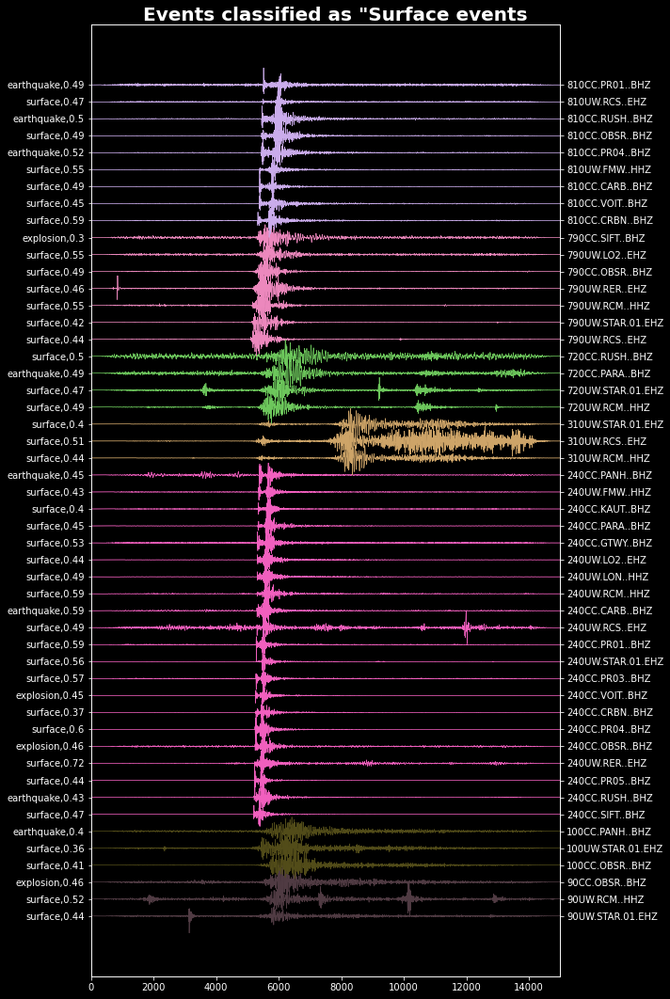

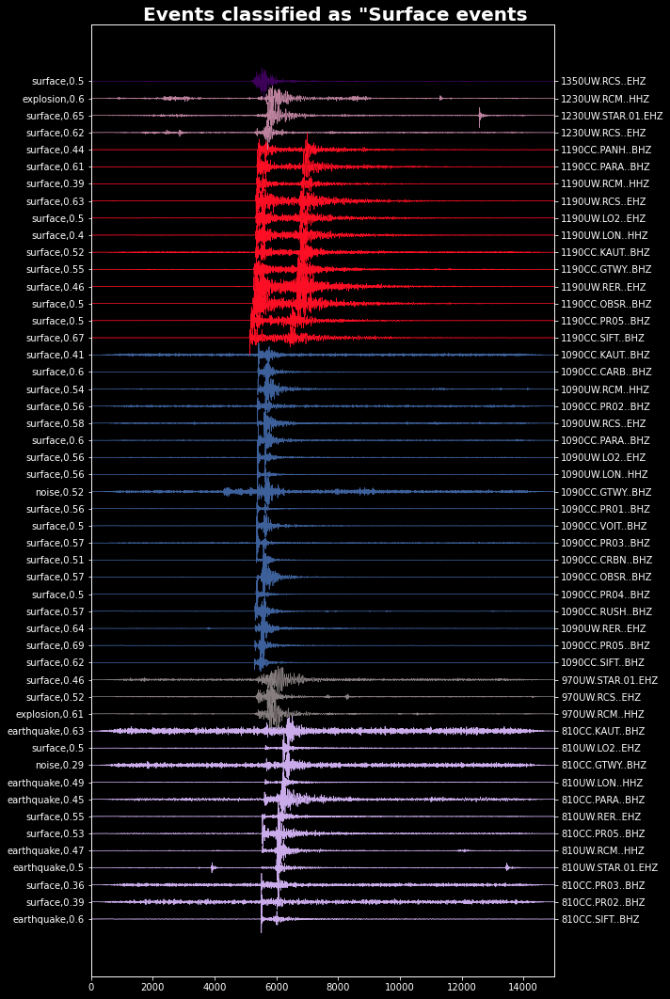

IndexError: index 108 is out of bounds for axis 0 with size 108

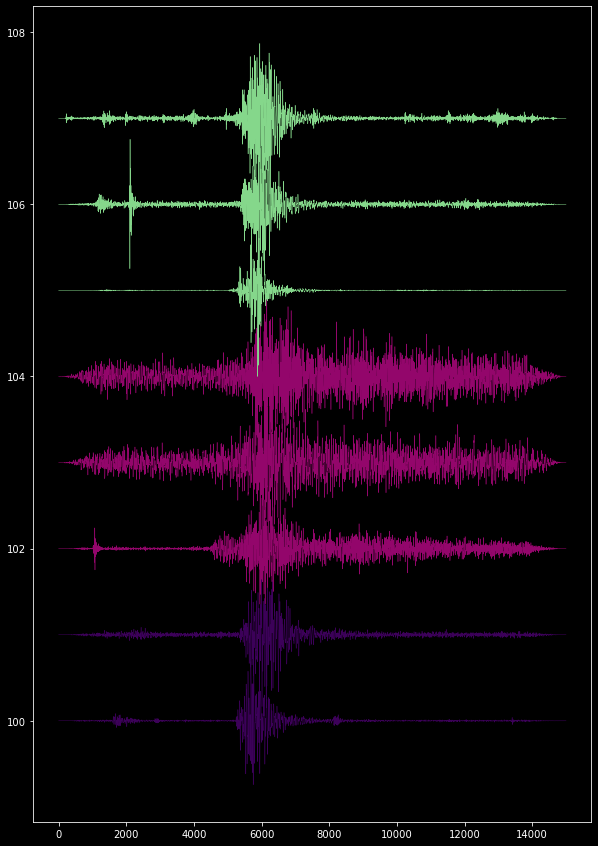

In [460]:
plt.style.use('dark_background')

for i in range(0,len(su_ids), 50):
    fig, ax = plt.subplots(figsize=[10, 15])

    l1 = i
    l2 = i+50

    for i in range(l1, l2):
        ax.plot(wf_su[i] + i, color=color_mapping[su_ids[i]], lw=0.5)

    # Corrected code for setting yticklabels
    yticks = np.arange(l1, l2)
    yticklabels = su_pred[l1:l2]+','+np.around(su_pred_probs[l1:l2],2).astype('str')
    ax.set_yticks(yticks)
    ax.set_yticklabels(yticklabels)


    ax1 = ax.twinx()

    for i in range(l1, l2):
        ax1.plot(wf_su[i] + i, color=color_mapping[su_ids[i]], lw=0.5)

    yticks = np.arange(l1, l2)
    yticklabels = su_pred_ids[l1:l2]   
    ax1.set_yticks(yticks)
    ax1.set_yticklabels(yticklabels)



    ax.set_xlim(0, 15000)

    fig.suptitle('Events classified as "Surface events', fontsize = 20, fontweight = 'bold')
    plt.savefig('../Test_Results/Classified_surface_events_'+str(i)+'_.png')
    plt.tight_layout()
    plt.show()


## Visualizing Explosion Waveforms

In [461]:
su_pred = all_df[all_df['event_class'] == 'explosion']['predicted_class'].values
su_pred_probs = np.max(probs[all_df['event_class'] == 'explosion'], axis = 1)
su_pred_ids = all_df[all_df['event_class'] == 'explosion']['all_ids'].values
su_ids = all_df[all_df['event_class'] == 'explosion']['event_id'].values
wf_su = norm[all_df[all_df['event_class'] == 'explosion'].index.values]

In [462]:
import random

# Your list of values
values = all_df[all_df['event_class'] == 'explosion']['event_id'].values

# Find unique values in the list
unique_values = list(set(values))

# Define a dictionary to map unique values to unique colors
color_mapping = {}
for value in unique_values:
    # Generate a random color (you can use your own color representation)
    color = "#{:02x}{:02x}{:02x}".format(random.randint(0, 255), random.randint(0, 255), random.randint(0, 255))
    color_mapping[value] = color

# Now, color_mapping contains unique colors for unique values
print(color_mapping)


{1410: '#a94b27', 900: '#6c85a8', 2180: '#619318', 390: '#d90d05', 1670: '#31ceff', 520: '#4ce301', 1930: '#977e23', 140: '#f02260', 270: '#56c100', 910: '#f9967d', 2190: '#e2e45b', 1170: '#5df3d1', 410: '#b32ea6', 1690: '#afc023', 930: '#5c4261', 550: '#f63a6d', 170: '#3858a8', 2090: '#44a42a', 1710: '#681e8b', 1200: '#e30eeb', 50: '#e44a4c', 1970: '#b06eca', 180: '#a11e45', 820: '#c1a896', 950: '#c6c625', 1460: '#037e37', 440: '#1141d0', 1080: '#8ff3f0', 570: '#32ef0c', 2100: '#739e00', 2110: '#1ec69b', 1860: '#f26049', 1990: '#0183a8', 840: '#d65011', 330: '#882c53', 1100: '#e2f906', 850: '#b7d56d', 1490: '#234f42', 1620: '#adeecb', 1240: '#853b6d', 2010: '#7f103f', 2140: '#85db9b', 1630: '#4fc95a', 2270: '#76dd3c', 1120: '#4e6bbd', 740: '#b0a803', 870: '#6f8fbb', 2150: '#95a250', 1000: '#dff436', 1640: '#6f7f47', 1770: '#bc8d8e', 620: '#f42f68', 1260: '#2f1f43', 750: '#3905ce', 1900: '#774562', 880: '#d23d72', 2030: '#8f4b5c', 2160: '#23060a', 1140: '#248af8'}


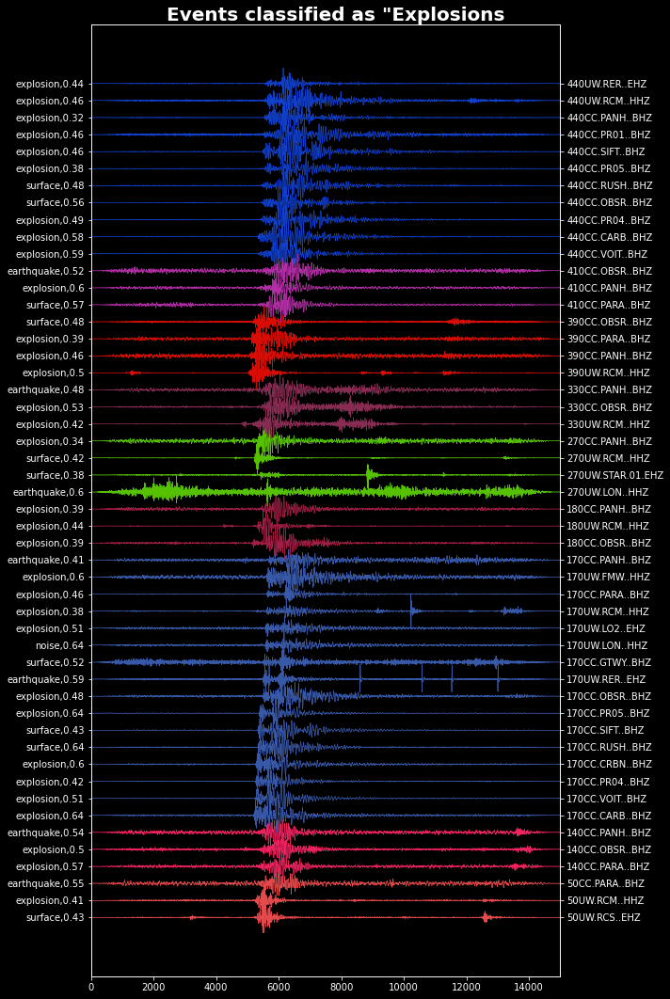

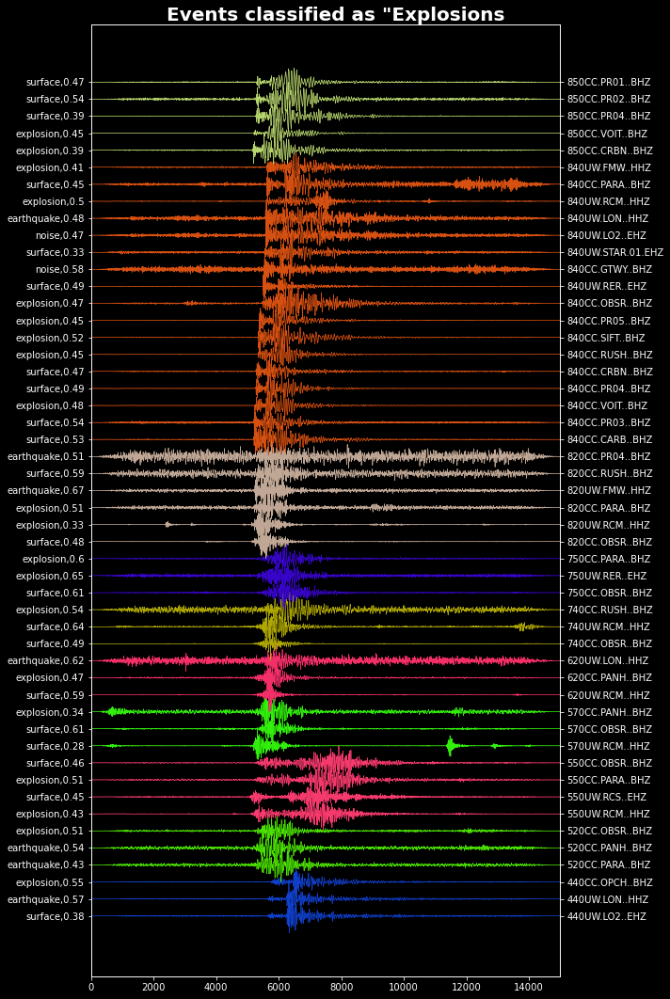

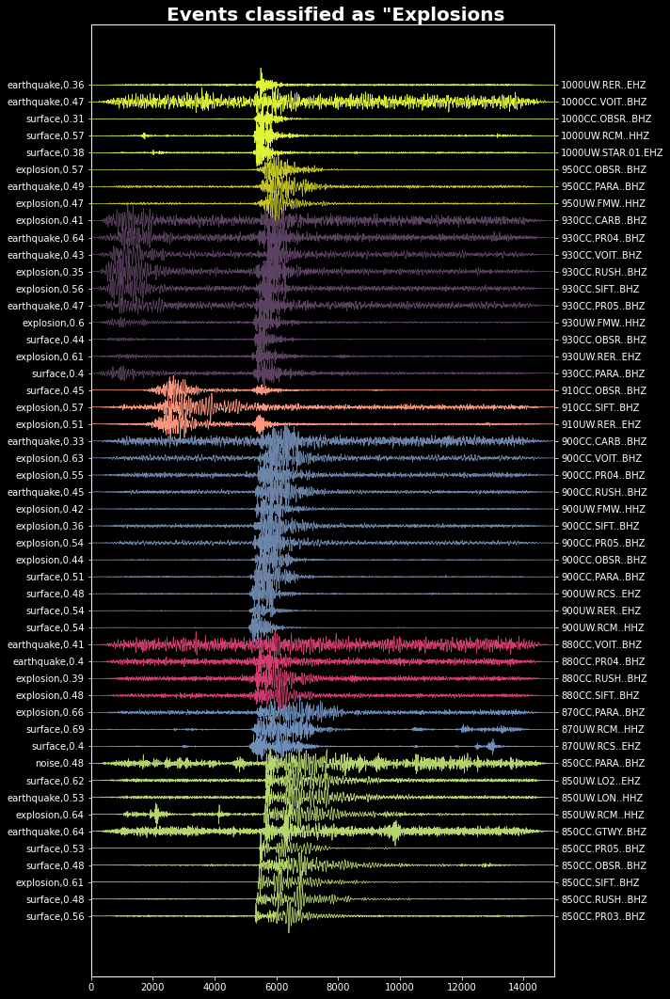

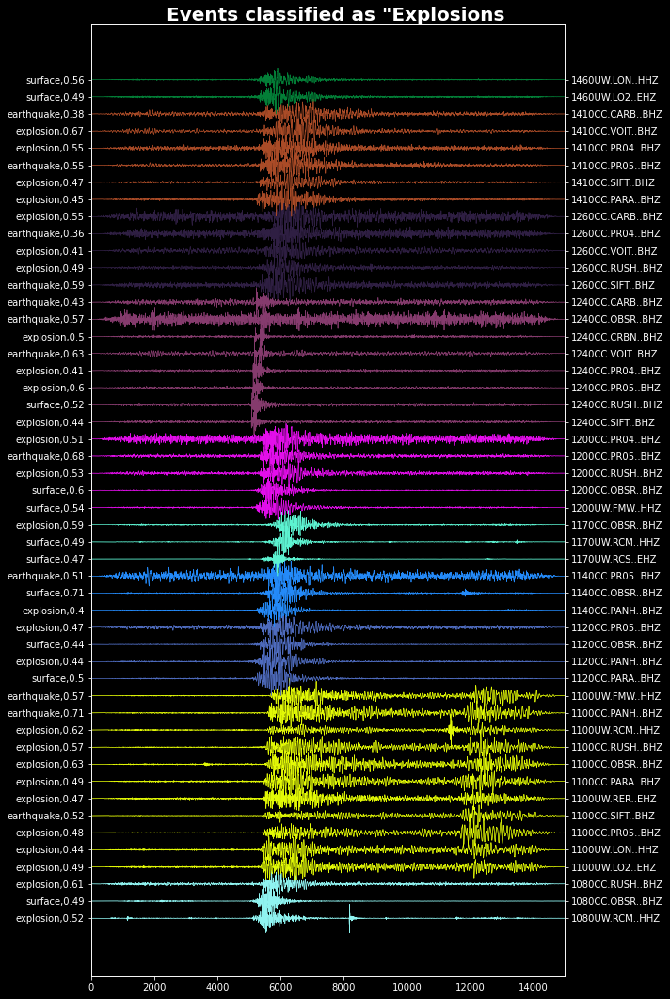

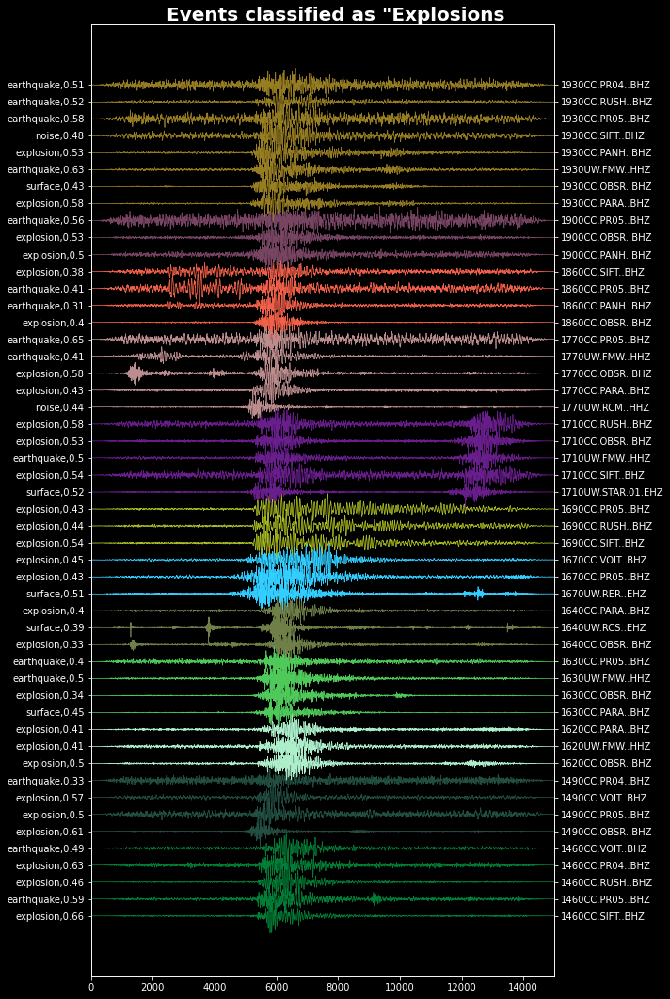

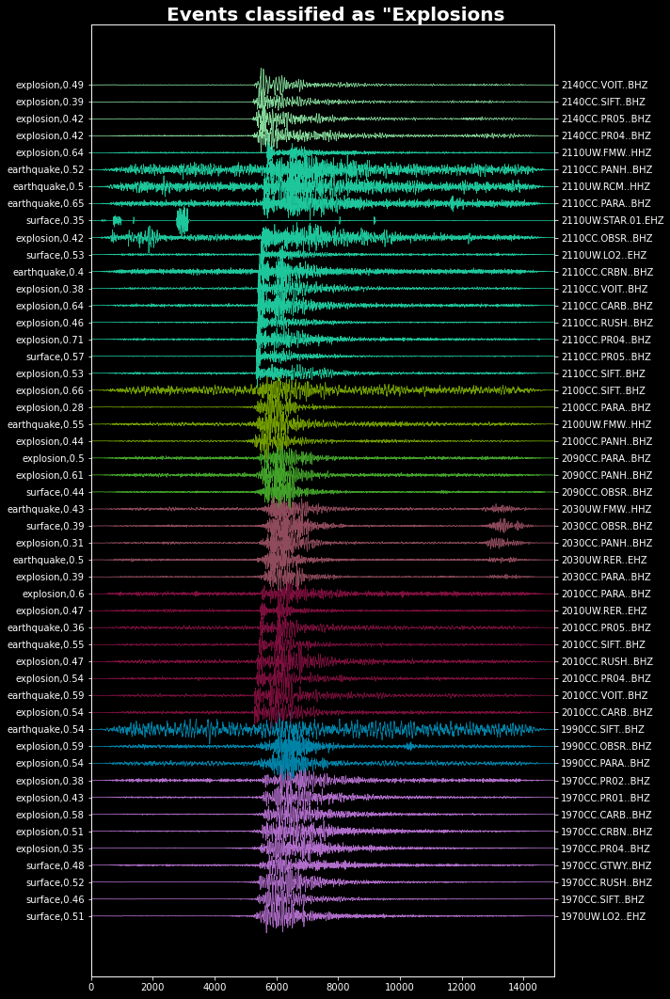

IndexError: index 346 is out of bounds for axis 0 with size 346

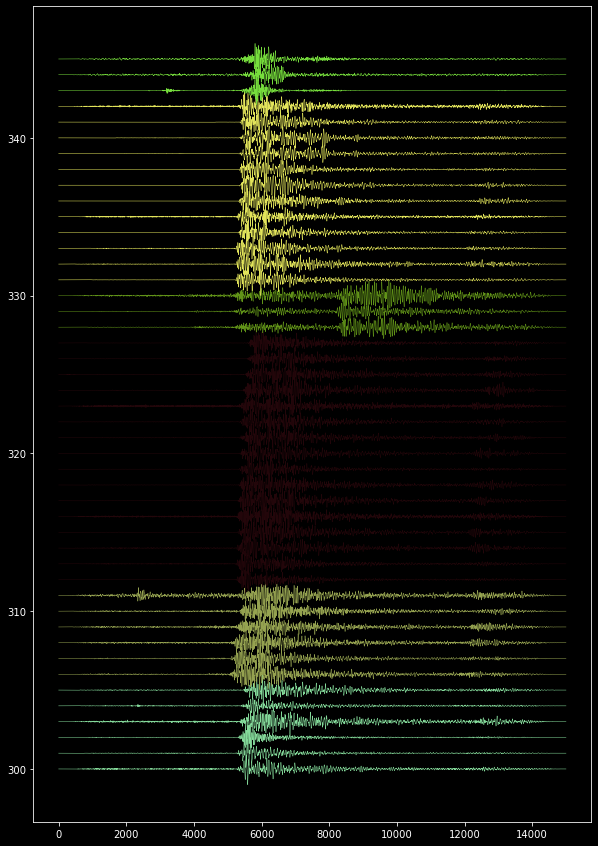

In [463]:
plt.style.use('dark_background')


for i in range(0, len(su_ids), 50):

    fig, ax = plt.subplots(figsize=[10, 15])

    l1 = i
    l2 = i+50

    for i in range(l1, l2):
        ax.plot(wf_su[i] + i, color=color_mapping[su_ids[i]], lw=0.5)

    # Corrected code for setting yticklabels
    yticks = np.arange(l1, l2)
    yticklabels = su_pred[l1:l2]+','+np.around(su_pred_probs[l1:l2],2).astype('str')
    ax.set_yticks(yticks)
    ax.set_yticklabels(yticklabels)


    ax1 = ax.twinx()

    for i in range(l1, l2):
        ax1.plot(wf_su[i] + i, color=color_mapping[su_ids[i]], lw=0.5)

    yticks = np.arange(l1, l2)
    yticklabels = su_pred_ids[l1:l2]   
    ax1.set_yticks(yticks)
    ax1.set_yticklabels(yticklabels)



    ax.set_xlim(0, 15000)

    fig.suptitle('Events classified as "Explosions', fontsize = 20, fontweight = 'bold')
    plt.savefig('../Test_Results/Classified_explosion_events_'+str(i)+'_.png')
    plt.tight_layout()
    plt.show()


## Visualizing earthquake waveforms

In [464]:
su_pred = all_df[all_df['event_class'] == 'earthquake']['predicted_class'].values
su_pred_probs = np.max(probs[all_df['event_class'] == 'earthquake'], axis = 1)
su_pred_ids = all_df[all_df['event_class'] == 'earthquake']['all_ids'].values
su_ids = all_df[all_df['event_class'] == 'earthquake']['event_id'].values
wf_su = norm[all_df[all_df['event_class'] == 'earthquake'].index.values]

In [465]:
import random

# Your list of values
values = all_df[all_df['event_class'] == 'earthquake']['event_id'].values

# Find unique values in the list
unique_values = list(set(values))

# Define a dictionary to map unique values to unique colors
color_mapping = {}
for value in unique_values:
    # Generate a random color (you can use your own color representation)
    color = "#{:02x}{:02x}{:02x}".format(random.randint(0, 255), random.randint(0, 255), random.randint(0, 255))
    color_mapping[value] = color

# Now, color_mapping contains unique colors for unique values
print(color_mapping)


{0: '#8a5184', 2050: '#eecd14', 1540: '#74f92f', 1030: '#7dce02', 10: '#0b9b58', 2060: '#9af378', 1550: '#243535', 1040: '#7d3919', 530: '#cb752f', 20: '#673440', 2070: '#14e75d', 1560: '#1ea775', 1050: '#e09f86', 540: '#a50d16', 30: '#d6374e', 2080: '#8f0412', 1570: '#0277ae', 1060: '#faf7d2', 40: '#43951d', 1580: '#37c10a', 1070: '#c24ef2', 560: '#36bc98', 60: '#9396d7', 1600: '#eba11a', 580: '#dc62ba', 70: '#a93abd', 2120: '#a7ad8b', 1610: '#6c1232', 590: '#fa7a0e', 80: '#f6f657', 2130: '#c98106', 1110: '#bb57a5', 600: '#fb89e9', 610: '#9591e8', 1130: '#341fd3', 110: '#d1381d', 1650: '#2fe92a', 630: '#2a3b65', 120: '#8ca826', 2170: '#72fdb4', 1660: '#3b8eaf', 1150: '#82bd7a', 640: '#422956', 130: '#39aabe', 1160: '#8740d7', 650: '#07a556', 1680: '#6735c9', 660: '#997f2a', 150: '#051823', 2200: '#f67048', 1180: '#84e412', 670: '#f2b783', 160: '#822a00', 2210: '#612374', 1700: '#b36278', 680: '#657fbf', 2220: '#ab7aa7', 690: '#5aaa76', 2230: '#d23a34', 1720: '#a95523', 1210: '#226e40'

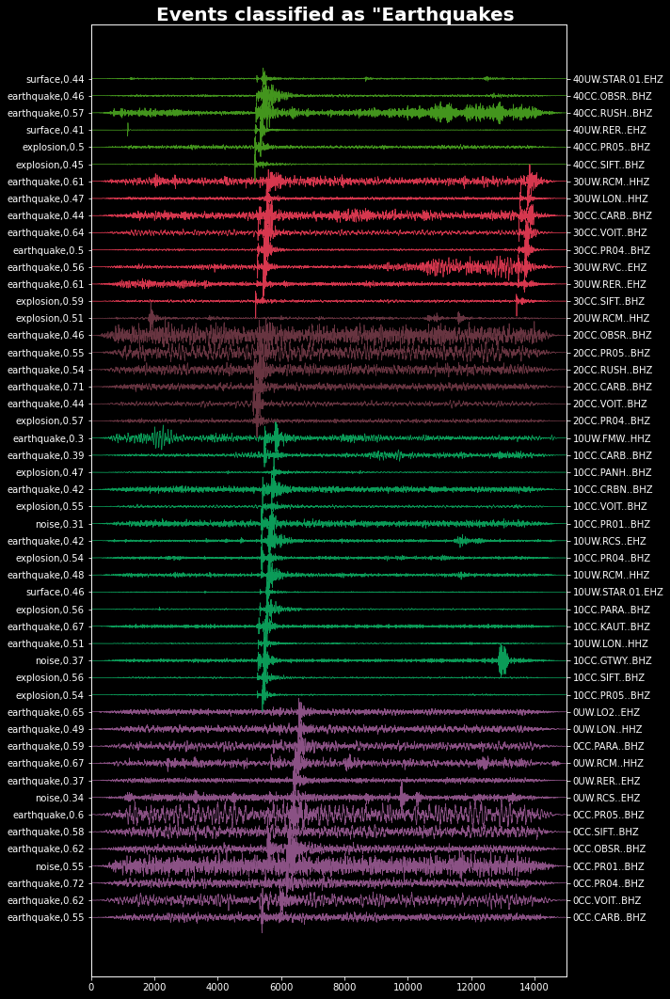

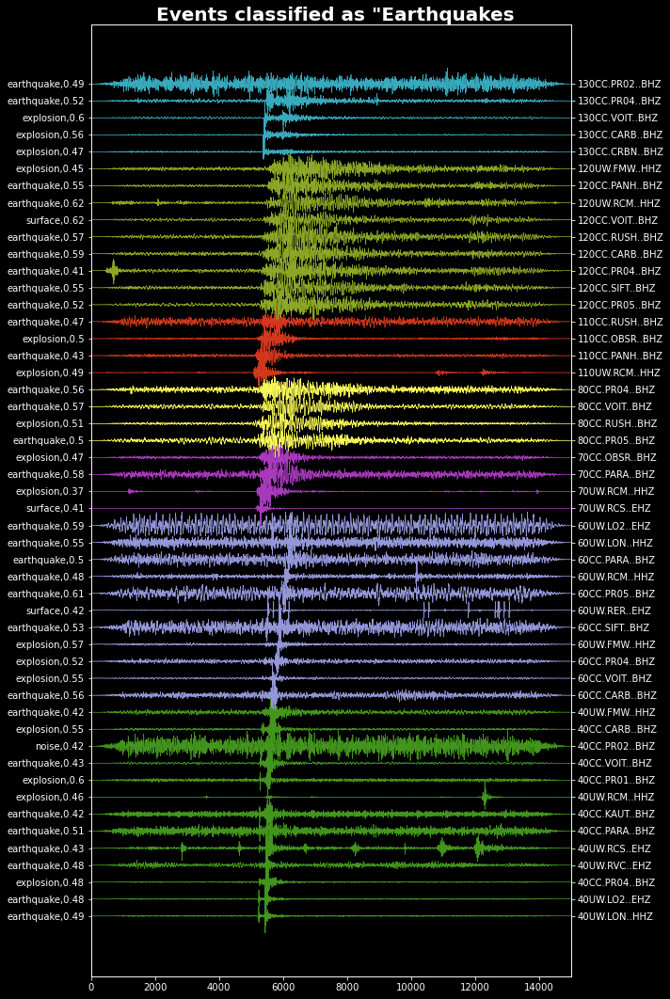

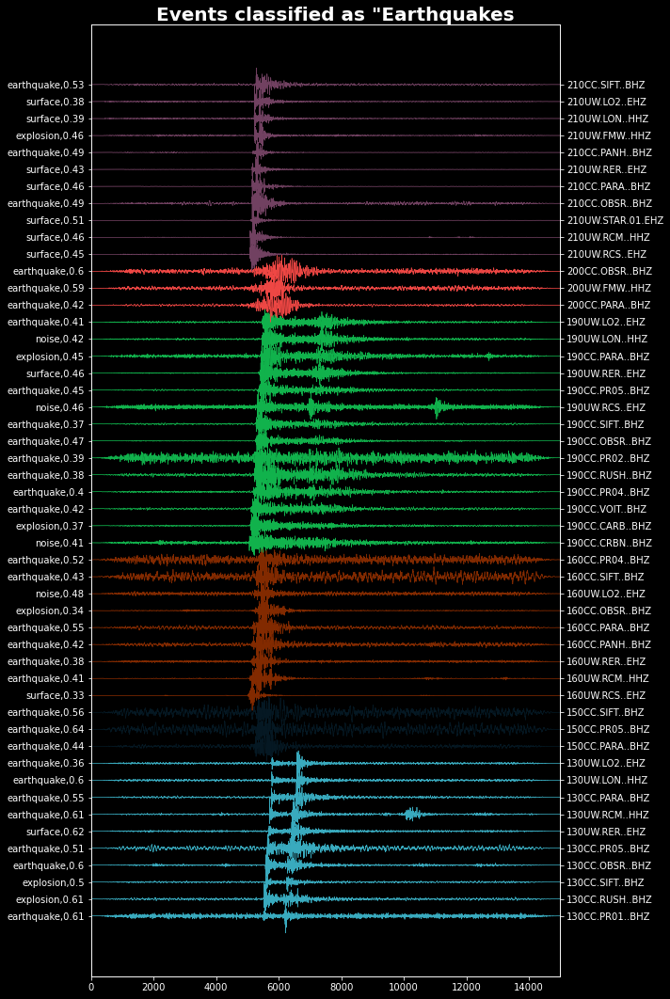

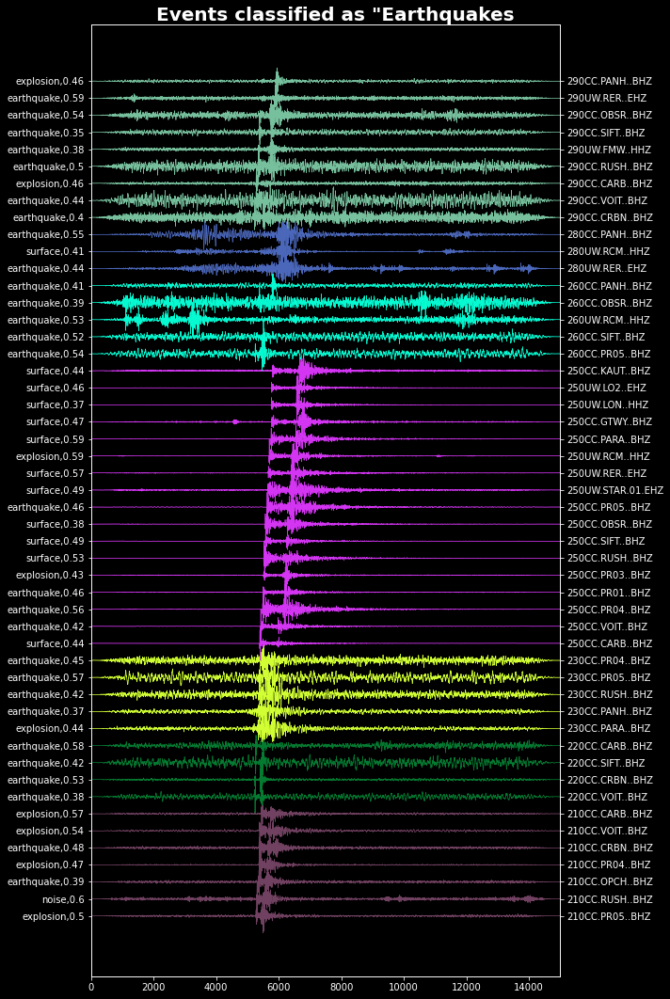

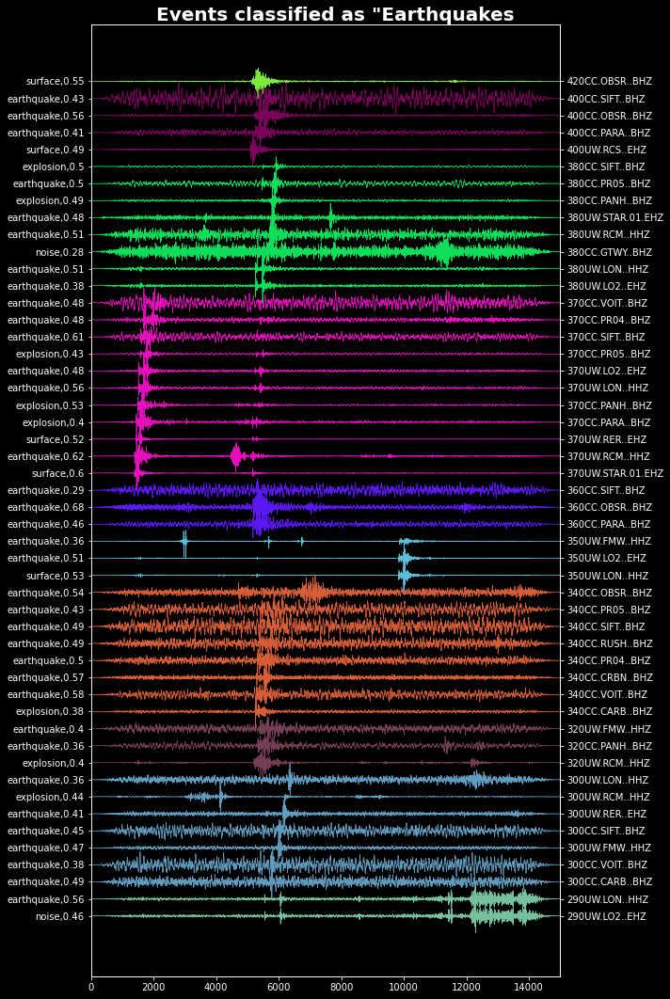

...

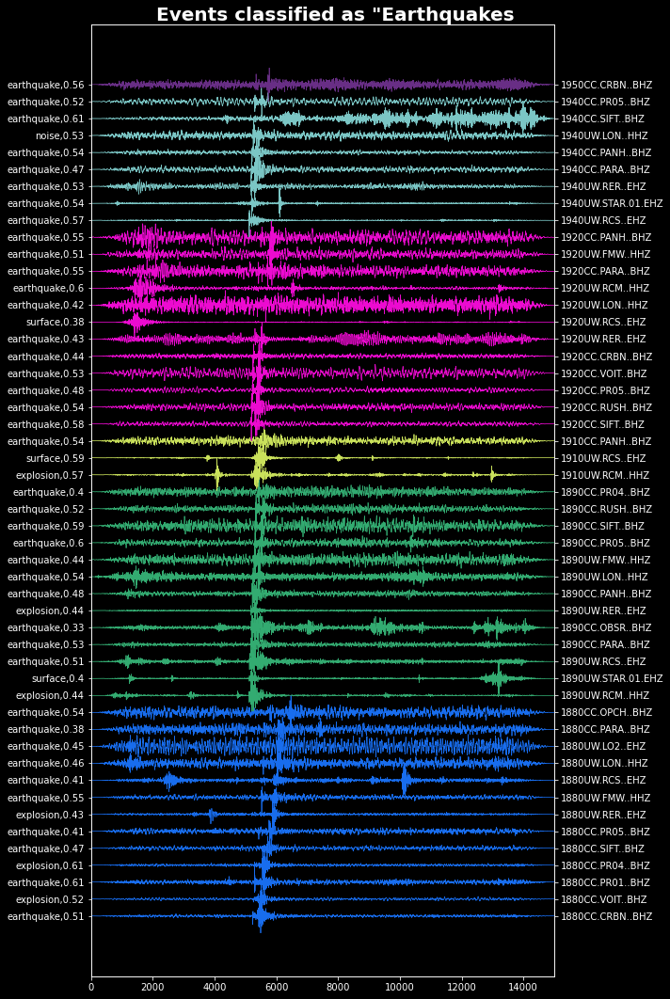

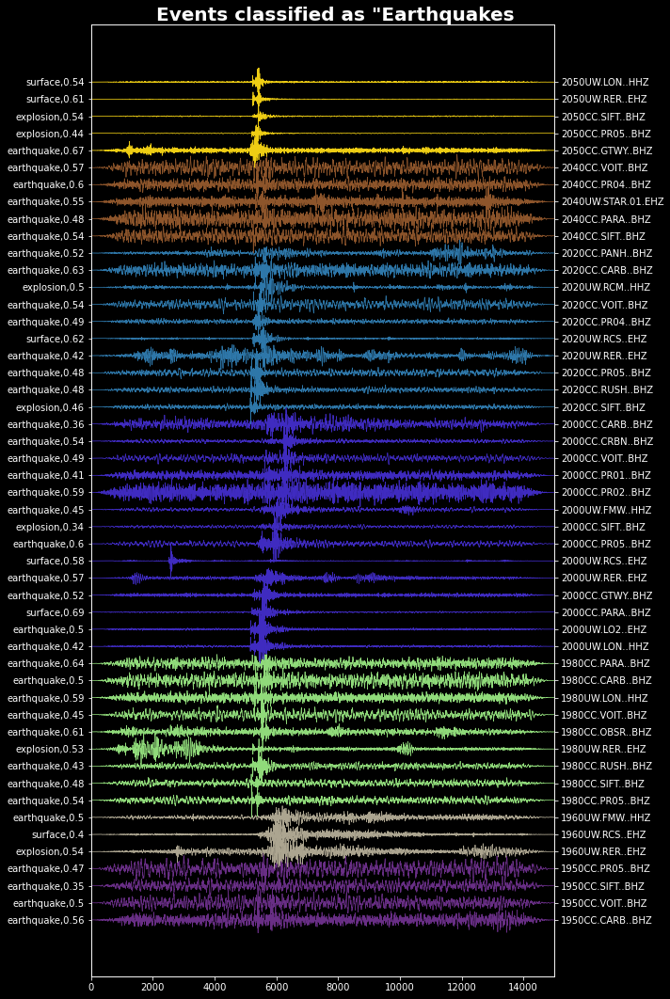

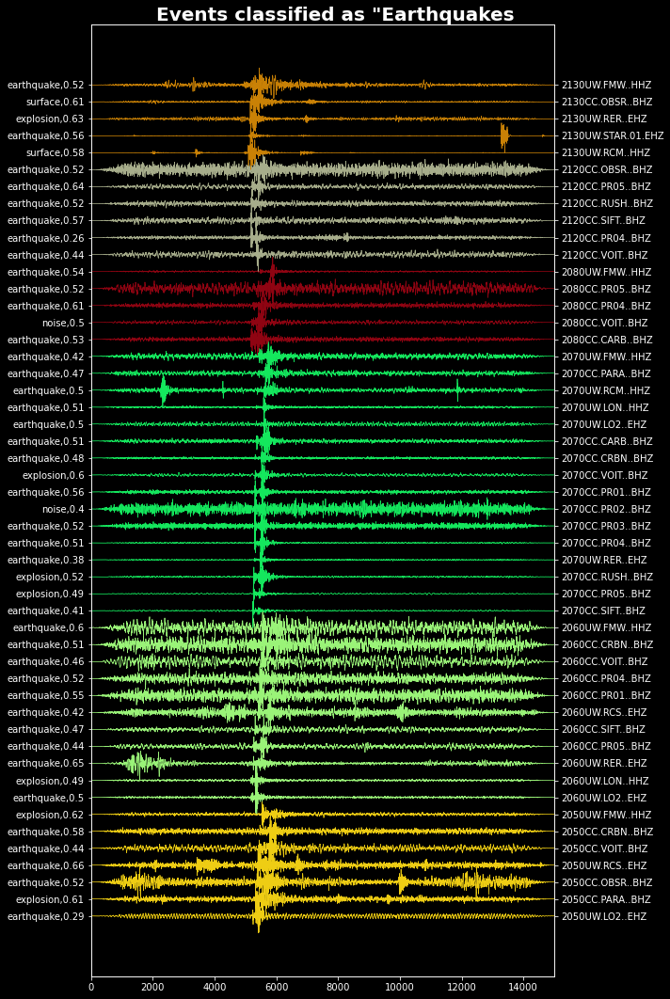

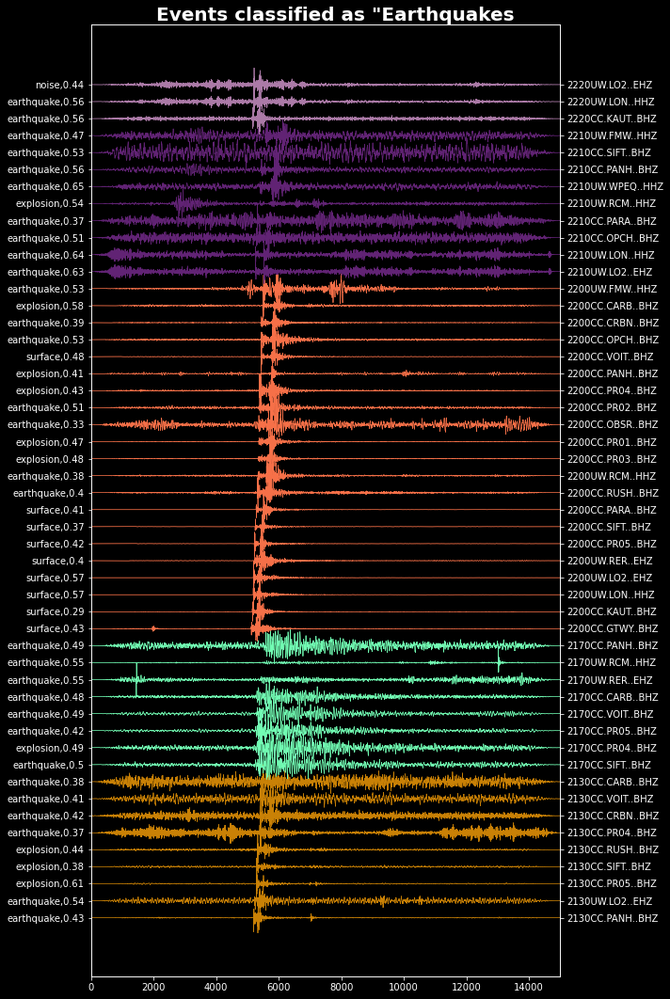

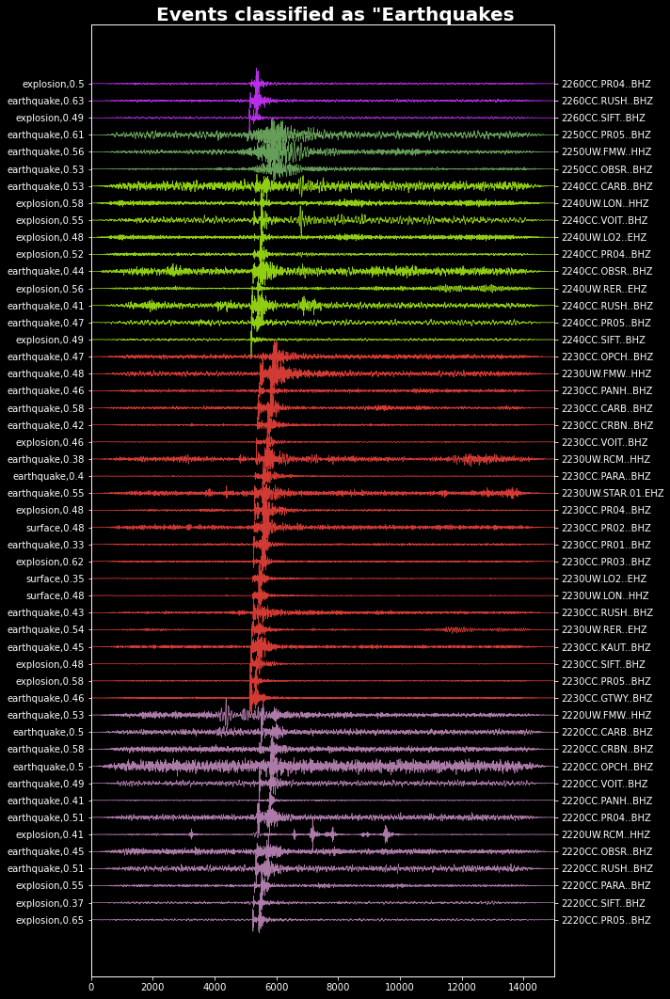

IndexError: index 1315 is out of bounds for axis 0 with size 1315

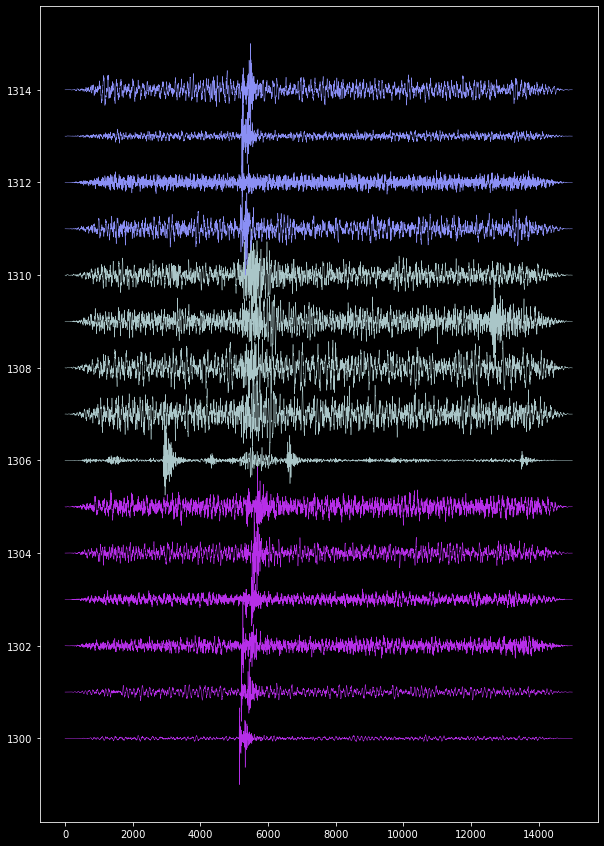

In [466]:
plt.style.use('dark_background')


for i in range(0, len(su_ids), 50):

    fig, ax = plt.subplots(figsize=[10, 15])

    l1 = i
    l2 = i+50

    for i in range(l1, l2):
        ax.plot(wf_su[i] + i, color=color_mapping[su_ids[i]], lw=0.5)

    # Corrected code for setting yticklabels
    yticks = np.arange(l1, l2)
    yticklabels = su_pred[l1:l2]+','+np.around(su_pred_probs[l1:l2],2).astype('str')
    ax.set_yticks(yticks)
    ax.set_yticklabels(yticklabels)


    ax1 = ax.twinx()

    for i in range(l1, l2):
        ax1.plot(wf_su[i] + i, color=color_mapping[su_ids[i]], lw=0.5)

    yticks = np.arange(l1, l2)
    yticklabels = su_pred_ids[l1:l2]   
    ax1.set_yticks(yticks)
    ax1.set_yticklabels(yticklabels)



    ax.set_xlim(0, 15000)

    fig.suptitle('Events classified as "Earthquakes', fontsize = 20, fontweight = 'bold')
    plt.savefig('../Test_Results/Classified_earthquake_events_'+str(i)+'_.png')
    plt.tight_layout()
    plt.show()


## Binary Classifier

In [332]:
# extracting the stored data
comcat_file_name = h5py.File("/data/whd01/yiyu_data/PNWML/comcat_waveforms.hdf5",'r')
exotic_file_name = h5py.File("/data/whd01/yiyu_data/PNWML/exotic_waveforms.hdf5",'r')
noise_file_name = h5py.File("/data/whd01/yiyu_data/PNWML/noise_waveforms.hdf5",'r')


# extracting the catalog
comcat_file_csv = pd.read_csv("/data/whd01/yiyu_data/PNWML/comcat_metadata.csv")
exotic_file_csv = pd.read_csv("/data/whd01/yiyu_data/PNWML/exotic_metadata.csv")
noise_file_csv = pd.read_csv("/data/whd01/yiyu_data/PNWML/noise_metadata.csv")



# extracting the metadata corresponding to individual events
cat_exp = comcat_file_csv[comcat_file_csv['source_type'] == 'explosion']
cat_eq = comcat_file_csv[comcat_file_csv['source_type'] == 'earthquake']
cat_no = noise_file_csv
cat_su = exotic_file_csv[exotic_file_csv['source_type'] == 'surface event']



# extracting the index 
ind_exp = X_scaled[X_scaled['source'] == 'explosion']['serial_no'].values
ind_eq = X_scaled[X_scaled['source'] == 'earthquake']['serial_no'].values
ind_no = X_scaled[X_scaled['source'] == 'noise']['serial_no'].values
ind_su = X_scaled[X_scaled['source'] == 'surface']['serial_no'].values




df_exp = X_scaled[X_scaled['source'] == 'explosion']
exp_df = cat_exp.iloc[ind_exp]
exp_df['serial_no'] = ind_exp


df_eq = X_scaled[X_scaled['source'] == 'earthquake']
eq_df = cat_eq.iloc[ind_eq]
eq_df['serial_no'] = ind_eq



df_no = X_scaled[X_scaled['source'] == 'noise']
no_df = cat_no.iloc[ind_no]
no_df['serial_no'] = ind_no



df_su = X_scaled[X_scaled['source'] == 'surface']
su_df = cat_su.iloc[ind_su]
su_df['serial_no'] = ind_su





new_exp = pd.merge(df_exp,exp_df, on = 'serial_no')
new_eq = pd.merge(df_eq,eq_df, on = 'serial_no')
new_su = pd.merge(df_su,su_df, on = 'serial_no')
new_no = pd.merge(df_no,no_df, on = 'serial_no')
new_no['event_id'] = np.array(['noise'+str(i) for i in np.arange(len(new_no))])



X_final = pd.concat([new_eq, new_su, new_no])
y = ['earthquake']*len(new_eq)+['surface']*len(new_su)+['noise']*len(new_no)






# new_exp contains the features and the corresponding metadata information. 
datetimes = X_final['trace_start_time'].values

hour_of_day = []
days_of_week = []
month_of_year = []
for dt_str in tqdm(datetimes):
        
    # Parse the datetime string
        dt = datetime.strptime(dt_str, '%Y-%m-%dT%H:%M:%S.%fZ')
        hod = dt.hour - 8.  # converting to local time. 
        moy = dt.month
        
        
        days_of_week.append(dt.weekday())
        hour_of_day.append(hod)
        month_of_year.append(moy)
        
X_final['hour_of_day'] = hour_of_day
X_final['day_of_week'] = days_of_week
X_final['month_of_year'] = month_of_year


temp_X = X_final.iloc[:,1:453]
temp_X = temp_X.assign(hod=X_final['hour_of_day'].values, dow=X_final['day_of_week'].values, moy=X_final['month_of_year'].values)

/home/ak287/miniconda3/envs/roses_2021/lib/python3.9/site-packages/pandas/core/frame.py:3607: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._set_item(key, value)
100%|██████████| 224811/224811 [00:01<00:00, 139852.97it/s]


In [323]:
## extracting metadata information for each kind of source along with features
a_eq = X_final[X_final['source_type'] == 'earthquake']
a_su = X_final[X_final['source_type'] == 'surface event']
a_no = X_final[X_final['source_type'] == 'noise']



## extracting the event ids corresponding to each catalog
eq_ids = np.unique(a_eq['event_id'].values)
su_ids = np.unique(a_su['event_id'].values)
no_ids = np.unique(a_no['event_id'].values)



## defining the events for training and testing in 70:30 ratio


train_eq = eq_ids[0:int(0.7*len(eq_ids))]
train_su = su_ids[0:int(0.7*len(su_ids))]
train_no = no_ids[0:int(0.7*len(no_ids))]


test_eq = eq_ids[int(0.7*len(eq_ids)):len(eq_ids)]
test_su = su_ids[int(0.7*len(su_ids)):len(su_ids)]
test_no = no_ids[int(0.7*len(no_ids)):len(no_ids)]





# concatenating training ids
all_train_ids = np.concatenate([train_eq, train_su, train_no])

# concatenating testing ids
all_test_ids = np.concatenate([test_eq, test_su, test_no])

# allocating event id as index
X_final.index = X_final['event_id'].values


# extracting training and testing values
X_train = X_final.loc[all_train_ids]
X_test = X_final.loc[all_test_ids]



Y_train = X_train['source_type'].values
Y_test = X_test['source_type'].values


x_train = X_train.iloc[:, 1:453]
print('len x_train:'+ str(len(x_train)))
x_train = x_train.assign(hod=X_train['hour_of_day'].values, dow=X_train['day_of_week'].values, moy=X_train['month_of_year'].values)

x_test = X_test.iloc[:, 1:453]
x_test = x_test.assign(hod=X_test['hour_of_day'].values, dow=X_test['day_of_week'].values, moy=X_test['month_of_year'].values)
print('len x_test:'+ str(len(x_test)))


len x_train:143078
len x_test:81733


In [333]:
rus = RandomUnderSampler(sampling_strategy={'earthquake':5000, 'surface':5000,'noise':5000})

# Initialize the LabelEncoder
label_encoder = LabelEncoder()
y_num_test = label_encoder.fit_transform(Y_test)

X_resampled, y_resampled = rus.fit_resample(temp_X, y)


# Fit the LabelEncoder on the text labels and transform them to numeric labels
y_num_res = label_encoder.fit_transform(y_resampled)



best_model.class_weight  = None
best_model.fit(X_resampled, y_num_res)

#y_pred = best_model.predict(x_test)


RandomForestClassifier(bootstrap=False, max_depth=50, max_features='sqrt',
                       min_samples_leaf=2, min_samples_split=5,
                       n_estimators=200, random_state=42)

In [334]:
features_all = pd.merge(tsfel_sorted, physical_sorted, on = 'all_ids')
features_all['start_time'] = sttimes


x_all = features_all.loc[:, x_test.columns.values[:-3]]

# Initialize the StandardScaler
scaler = StandardScaler()

# Apply standard scaling to the DataFrame
scaled_features = scaler.fit_transform(x_all)

# Create a new DataFrame with scaled features
x_all_scaled = pd.DataFrame(scaled_features, columns=x_all.columns)



# new_exp contains the features and the corresponding metadata information. 
datetimes = features_all['start_time'].values.astype('str')

hour_of_day = []
days_of_week = []
month_of_year = []
for dt_str in tqdm(datetimes):
        
    # Parse the datetime string
        dt = datetime.strptime(dt_str, '%Y-%m-%dT%H:%M:%S.%fZ')
        hod = dt.hour - 8.  # converting to local time. 
        moy = dt.month
        
        
        days_of_week.append(dt.weekday())
        hour_of_day.append(hod)
        month_of_year.append(moy)
        
features_all['hod'] = hour_of_day
features_all['dow'] = days_of_week
features_all['moy'] = month_of_year


x_all_scaled['hod'] = features_all['hod']
x_all_scaled['dow'] = features_all['dow']
x_all_scaled['moy'] = features_all['moy']


x_yiyu = x_all_scaled



/home/ak287/miniconda3/envs/roses_2021/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1745: RuntimeWarning: overflow encountered in multiply
  sqr = np.multiply(arr, arr, out=arr, where=where)
100%|██████████| 1769/1769 [00:00<00:00, 127741.27it/s]


In [335]:
y_pred_yiyu = best_model.predict(x_yiyu)
probs = best_model.predict_proba(x_yiyu)

In [336]:
Counter(y_pred_yiyu)

Counter({0: 1360, 1: 46, 2: 363})